# Cellular Organization of Barrel Cortex

In [1]:
# import packages

%matplotlib inline
#%config InlineBackend.print_figure_kwargs={'bbox_inches':None}
#%config InlineBackend.figure_format = 'png'
import os
import matplotlib.pyplot as plt
from scipy.spatial import distance
import tifffile
import glob
from IPython.display import Markdown, display, HTML, YouTubeVideo
from matplotlib import animation, rc, gridspec
import matplotlib.image as mpimg
from itertools import groupby, chain
#from matplotlib.ticker import MaxNLocator
import collections
from scipy.ndimage.interpolation import rotate
import numpy as np
import ijroi
import warnings
from cmath import rect
from mpl_toolkits.mplot3d import Axes3D
import ipyvolume.pylab as p3
from skimage import measure
import javabridge
import bioformats
from scipy import optimize
import pdb
import plotly
import re
import pandas as pd
plotly.offline.init_notebook_mode()
javabridge.start_vm(class_path=bioformats.JARS)
warnings.filterwarnings('ignore')

params = {
    #'figure.figsize': [10, 7.5], # instead of 4.5, 4.5, larger figsizes make figs larger at to certain point. There exits a limit.
    'figure.max_open_warning': 0,
    #'figure.dpi': 300,
    #'savefig.dpi':300
    }
plt.rcParams.update(params)

In [2]:
def load_bioformats_img(path, z=0, c=0):
    import xml.etree.ElementTree as ET
    
    root = ET.fromstring(bioformats.get_omexml_metadata(path=path))
    nsmap = {'n': 'http://www.openmicroscopy.org/Schemas/OME/2015-01'}
    pixel = root.find('n:Image', namespaces=nsmap).find('n:Pixels', namespaces=nsmap)
    try:
        pixel_size = dict(x=float(pixel.get('PhysicalSizeX')), y=float(pixel.get('PhysicalSizeY')), z=float(pixel.get('PhysicalSizeZ')))
    except(TypeError):
        pixel_size = dict(x=float(pixel.get('PhysicalSizeX')), y=float(pixel.get('PhysicalSizeY')))
    if z==-1:
        z = range(int(pixel.get('SizeZ')))
    elif type(z)==int:
        z = [z]
    img_stack = [bioformats.load_image(path, z=frame, c=c, rescale=False) for frame in z]
    img = np.transpose(np.dstack(img_stack), axes=(2,0,1))
    
    return (img, pixel_size)

## Comparison of CUBIC mount, ScaleSQ, and TDE

The "CUBIC mount" was originally developed by Lee et al., 2015, and is derived from the original CUBIC technique (Susaki et. al, 2015). The fixed brain was rapidly cleared in this solution.

This mounting medium was compared with [ScaleSQ](http://www.nature.com/neuro/journal/v18/n10/fig_tab/nn.4107_F7.html) and [TDE in PBS](http://www.nature.com/articles/srep09808), other rapid tissue-clearing techniques.

First, coronal slices were imaged after clearing with various solutions. Here are the settings for imaging:

Camera: Leica MC 120HD

Microscope: Leica MZ 10F

White balance: 38, 32, 0 (red, blue, black)

Exposure: 91

Gain: 107

Brightness: 127

Gamma: 0.55

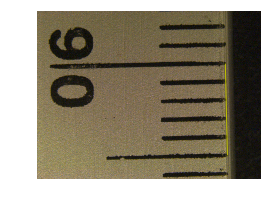

In [4]:
scale = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK557/Anatomy/scale.JPG");
plt.figure(figsize=(4, 3))
plt.imshow(scale)
plt.autoscale(False)
plt.axis('off')
plt.plot([1541, 1558], [430, 1171], 'y')
scale_factor = 5 / distance.euclidean([1541, 430], [1558, 1171]) # mm/pixel

In [5]:
#adopted from the implemetation by @Mahdi: http://stackoverflow.com/questions/24467972/calculate-area-of-polygon-given-x-y-coordinates
def polygon_area(imagej_roi):
    x = imagej_roi[:, 0].astype(int)
    y = imagej_roi[:, 1].astype(int)
    return 0.5 * np.abs(np.dot(x, np.roll(y, 1)) - np.dot(y, np.roll(x, 1)))

The coronal slices (750 um) from TK563 were cleared with cubic mounting medium, 47% TDE, 60% TED, ScaleSQ(5) followed by ScaleS4(0). The room temperature was 23.3 C (12:00 23.3.2017).

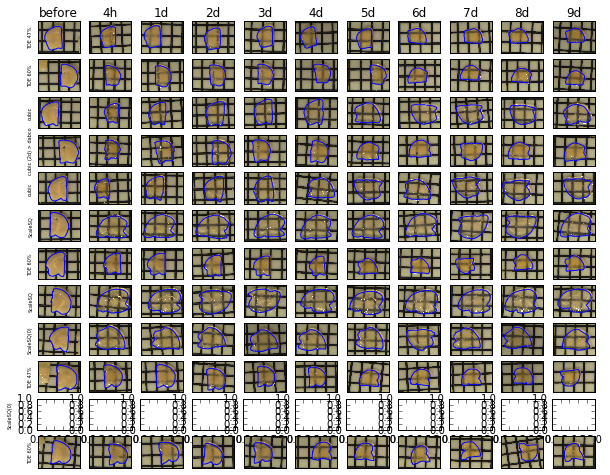

In [13]:
fig, axes = plt.subplots(nrows=12, ncols=11, figsize=(10, 8)#sharex='col', #sharey=True, gridspec_kw={'height_ratios': [2, 2, 2, 0.1]}
                        )
slicesTK563 = []
methods = ['TDE 47%', 'TDE 60%', 'cubic', 'cubic (2d) > dabco', 'cubic', 'ScaleSQ', 'TDE 60%', 'ScaleSQ', 'ScaleSQ(0)', 'TDE 47%', 'ScaleSQ(0)', 'TDE 60%']

for i in list(range(10)) + [11]:
    areas = []
    for j in range(11):
        axes[i, j].imshow(mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK563/Anatomy/slice{}_{}.JPG".format(i, j)))
        axes[i, j].autoscale(False)
        with open("C:/Users/kiritani/Documents/data/cells/TK563/Anatomy/slice{}_{}.roi".format(i, j), "rb") as f:
            roi = ijroi.read_roi(f).points
            axes[i, j].plot(roi[:, 1], roi[:, 0])
            areas.append(polygon_area(roi))
            axes[i, j].set_xticks([])
            axes[i, j].set_yticks([])
    slicesTK563.append({'area': areas, 'method': methods[i]})
            
for i, t in enumerate(['before', '4h', '1d', '2d', '3d', '4d', '5d', '6d', '7d', '8d', '9d']):
    axes[0, i].set_title(t)

for i, method in enumerate(methods):
    axes[i, 0].set_ylabel(method, size=5)

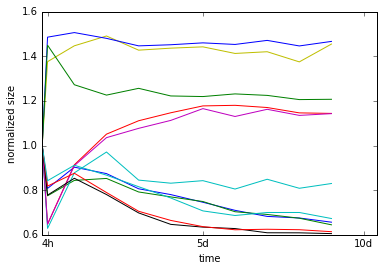

In [14]:
for s in slicesTK563:
    plt.plot([0, 4] +  list(range(24, 24 * 10, 24)), s['area'] / s['area'][0], label=s['method'])
#plt.legend()
plt.ylabel('normalized size')
plt.xlabel('time')
plt.xticks([4, 24 * 5, 24 * 10], ['4h', '5d', '10d']);

The coronal slices (750 um) from TK565 were cleared with cubic mounting medium, 47% TDE, 60% TED, ScaleSQ(5) followed by ScaleS4(0) and ScaleSQ(0) followed by ScaleS4(0). The room temperature was 23.2 C (13:00 24.3.2017).

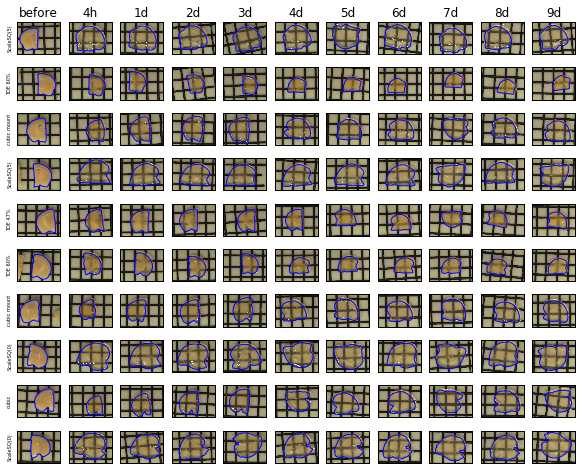

In [22]:
fig, axes = plt.subplots(nrows=10, ncols=11, figsize=(10, 8)#sharex='col', #sharey=True, gridspec_kw={'height_ratios': [2, 2, 2, 0.1]}
                        )

slicesTK565 = []
methods = ['ScaleSQ(5)', 'TDE 60%', 'cubic mount', 'ScaleSQ(5)', 'TDE 47%', 'TDE 60%', 'cubic mount', 'ScaleSQ(0)', 'cubic', 'ScaleSQ(0)',]

for i in range(10):
    areas = []
    for j in range(11):
        axes[i, j].imshow(mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK565/Anatomy/slice{}_{}.JPG".format(i, j)))
        axes[i, j].autoscale(False)
        with open("C:/Users/kiritani/Documents/data/cells/TK565/Anatomy/slice{}_{}.roi".format(i, j), "rb") as f:
            roi = ijroi.read_roi(f).points
            axes[i, j].plot(roi[:, 1], roi[:, 0])
            areas.append(polygon_area(roi))
            axes[i, j].set_xticks([])
            axes[i, j].set_yticks([])
    slicesTK565.append({'area': areas, 'method': methods[i]})
            
for i, t in enumerate(['before', '4h', '1d', '2d', '3d', '4d', '5d', '6d', '7d', '8d', '9d']):
    axes[0, i].set_title(t)

for i, method in enumerate(methods):
    axes[i, 0].set_ylabel(method, size=5)

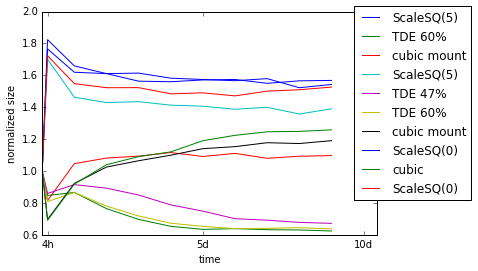

In [26]:
for s in slicesTK565:
    plt.plot([0, 4] +  list(range(24, 24 * 10, 24)), s['area'] / s['area'][0], label=s['method'])
plt.legend(bbox_to_anchor=(1.3, 1.05))
plt.ylabel('normalized size')
plt.xlabel('time')
plt.xticks([4, 24 * 5, 24 * 10], ['4h', '5d', '10d']);

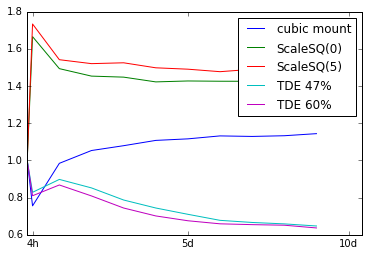

In [27]:
methods = ['cubic mount', 'ScaleSQ(0)', 'ScaleSQ(5)', 'TDE 47%', 'TDE 60%']
slices_grouped = {}
for method in methods:
    slices = [s for s in slicesTK563 if s['method'] == method] + [s for s in slicesTK565 if s['method'] == method]
    slices_grouped[method] = [s['area']/s['area'][0] for s in slices]

plt.figure()
for m in methods:
    size = []
    std = []
    sg = slices_grouped[m]
    for i in range(11):
        size.append(np.mean([cn[i] for cn in sg]))
        std.append(np.std([cn[i] for cn in sg]))
    plt.plot([0, 4] +  list(range(24, 24 * 10, 24)), size, label=m)
plt.legend()
plt.xticks([4, 24 * 5, 24 * 10], ['4h', '5d', '10d']);

The confocal images of cleared brains. Coronal slices were incubated in tissue-clearing solutions for 2 days (or cubic 2d > dabco 1d), and imaged using the UP2 confocal microscope at BIOP. All images were taken under the same settings.

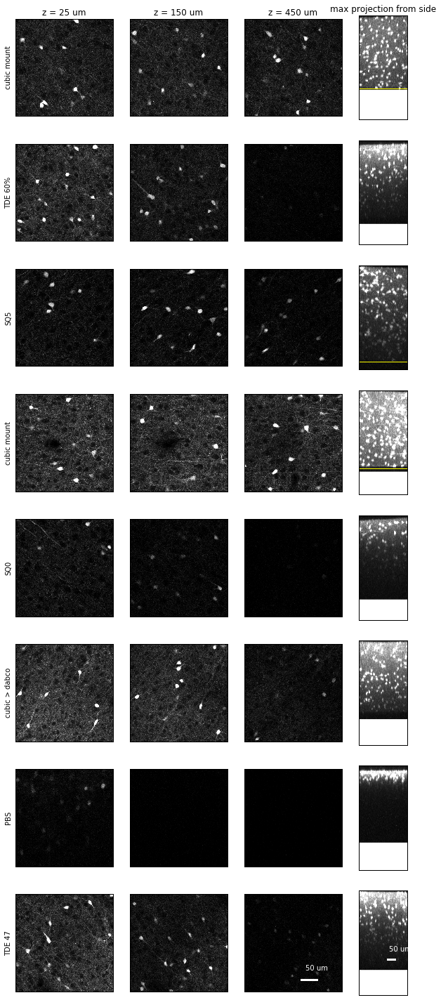

In [28]:
fig, axes = plt.subplots(nrows=8, ncols=4, figsize=(10, 25), gridspec_kw={'width_ratios': [1, 1, 1, 0.5]}
                        )
surface_frame = [3, 7, 5, 3, 7, 4, 7, 4]
bottom_frame = [96, None, 127, 103, None, None, None, None]
vmin = 0
vmax = 40
methods = [ 'cubic mount', 'TDE 60%', 'SQ5', 'cubic mount', 'SQ0', 'cubic > dabco', 'PBS', 'TDE 47']
slice_nums = [1, 2, 3, 4, 5, 8, 9, 10]
for i, slice_num in enumerate(slice_nums):
    img = tifffile.imread("C:/Users/kiritani/Documents/data/cells/TK567/Anatomy/slice{}_stack.lsm".format(slice_num))
    axes[i, 0].imshow(img[0, 0, surface_frame[i] + 15], vmin=vmin, vmax=vmax, cmap='gray') # 5 * 5 = 25 um deep
    axes[i, 1].imshow(img[0, 0, surface_frame[i] + 30], vmin=vmin, vmax=vmax, cmap='gray') # 150 um deep
    axes[i, 2].imshow(img[0, 0, surface_frame[i] + 60], vmin=vmin, vmax=vmax, cmap='gray') # 450 um deep
    axes[i, 0].set_ylabel(methods[i])
    side = np.amax(img[0, 0, :, 0:256, :], 1)
    side = np.concatenate([side, np.ones((138-img.shape[2], 512)).astype(int) * 256])
    axes[i, 3].imshow(side, vmin=vmin, vmax=vmax, cmap='gray', )
    if bottom_frame[i]:
        axes[i, 3].axhline(bottom_frame[i], color='yellow')
    axes[i, 3].set_aspect(5 / 0.625169)
    
for ax in fig.axes:
    ax.set_xticks([])
    ax.set_yticks([])

axes[0, 0].set_title('z = 25 um')
axes[0, 1].set_title('z = 150 um')
axes[0, 2].set_title('z = 450 um')
axes[0, 3].set_title('max projection from side')

axes[7, 2].autoscale(False)
axes[7, 2].plot([300, 300 + 50 / 0.625169], [450, 450], 'white', lw=3)
axes[7, 2].text(320, 400, '50 um', color='white')
axes[7, 3].autoscale(False)
axes[7, 3].plot([300, 300 + 50 / 0.625169], [90, 90], 'white', lw=3)
axes[7, 3].text(320, 80, '50 um', color='white');

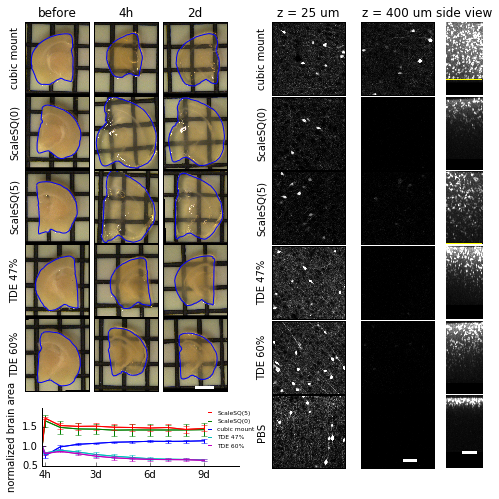

In [31]:
# summary fig for the comparison of rapid brain-clearing techniques

methods = ['cubic mount', 'ScaleSQ(0)', 'ScaleSQ(5)', 'TDE 47%', 'TDE 60%']
times = ['before', '4h', '2d']
slice_num = [6, 7, 3, 4, 5]
fig = plt.figure(figsize=(6.85, 8))
gs1 = gridspec.GridSpec(5, 3, left=0.03, right=0.45, bottom=0.26, wspace=0, hspace=0.02)
width = 1368
height = 1400
rot = [[0, 0, 0], [0, -86, -90], [0, -93, -88], [0, -1.5, 0], [2, 0, 0]]
x_offset = [[0, 200, 100], [200, 100, 0], [450, 150, 0], [600, 400, 100], [400, 350, 400]]
y_offset = [[0, 0, 0], [0, 385, 200], [0, 370, 300], [0, 0, 0], [0, -20, 20]]
for i in range(5):
    for j, d in enumerate([0, 1, 3]):
        ax = fig.add_subplot(gs1[i, j], axisbg='k')
        img = rotate(mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK565/Anatomy/slice{}_{}.JPG".format(slice_num[i], d)), rot[i][j])
        ax.imshow(img)
        ax.set_xlim((x_offset[i][j], x_offset[i][j] + 1250))
        ax.set_ylim((y_offset[i][j] + height, y_offset[i][j]))
        ax.set_xticks([])
        ax.set_yticks([])
        if j == 0:
            ax.set_ylabel(methods[i])
        if i == 0:
            ax.set_title(times[j])
        
        with open("C:/Users/kiritani/Documents/data/cells/TK565/Anatomy/slice{}_{}.roi".format(slice_num[i], d), "rb") as f:
                roi = ijroi.read_roi(f).points
                roi_rotated = (roi[:, 1] - 912 + (roi[:, 0] - 684) * 1j) * rect(1, rot[i][j] / -180 * np.pi) + complex(img.shape[1], img.shape[0])/2
                ax.plot([r.real for r in roi_rotated], [r.imag for r in roi_rotated])
ax.plot([1050, 1050 + 2 / scale_factor], [1350, 1350], 'white', lw=3) # scale bar of 2 mm


ax = fig.add_axes([0.07, 0.13, 0.4, 0.1], #aspect=68)
                 )
slices_grouped = {}
for method in methods:
    slices = [s for s in slicesTK563 if s['method'] == method] + [s for s in slicesTK565 if s['method'] == method]
    slices_grouped = [s['area']/s['area'][0] for s in slices]
    size = []
    std = []
    for i in range(11):
        size.append(np.mean([cn[i] for cn in slices_grouped]))
        std.append(np.std([cn[i] for cn in slices_grouped]))
    p = ax.plot([0, 4] +  list(range(24, 24 * 10, 24)), size, label=method)
    ax.errorbar([0, 4] +  list(range(24, 24 * 10, 24)), size, yerr=std, color=p[0].get_color())

ax.set_xticks([4, 24 * 3, 24 * 6, 24 * 9])
ax.set_xticklabels(['4h', '3d', '6d', '9d'])
ax.set_yticks([0.5, 1, 1.5])
ax.set_ylabel('normalized brain area')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
ax.set_xlim((0, 24 * 11))
handles,labels = ax.get_legend_handles_labels()
handles = [handles[2], handles[1], handles[0], handles[3], handles[4]]
labels = [labels[2], labels[1], labels[0], labels[3], labels[4]]
leg = ax.legend(handles, labels, bbox_to_anchor=(.82, 1), loc=2, borderaxespad=0., columnspacing=2,fontsize=6, frameon=False, handlelength=1)

gs2 = gridspec.GridSpec(6, 3, width_ratios=[1, 1, 0.5], left=0.52, right=0.97, wspace=0, hspace=0.02)
surface_frame = [3, 7, 5, 3, 7, 4, 7, 4]
bottom_frame = [100, None, 127, None, None, None, None, None]
vmin = 0
vmax = 60
slice_nums = [4, 5, 3, 10, 2, 9]
for i, slice_num in enumerate(slice_nums):
    img = tifffile.imread("C:/Users/kiritani/Documents/data/cells/TK567/Anatomy/slice{}_stack.lsm".format(slice_num))
    ax_25 = fig.add_subplot(gs2[i, 0])
    ax_25.imshow(img[0, 0, surface_frame[i] + 5], vmin=vmin, vmax=vmax, cmap='gray') # 5 * 5 = 25 um deep
    ax_25.set_xticks([])
    ax_25.set_yticks([])
    ax_25.set_ylabel((methods + ['PBS'])[i])
    ax_400 = fig.add_subplot(gs2[i, 1])
    ax_400.imshow(img[0, 0, surface_frame[i] + 80], vmin=vmin, vmax=vmax, cmap='gray') # 400 um deep
    ax_400.set_xticks([])
    ax_400.set_yticks([])
    side = np.amax(img[0, 0], 1)#[:100,:]
    side = np.concatenate([side, np.ones((138 - img.shape[2], 512)).astype(int) * 0])[:130, :]
    ax_side = fig.add_subplot(gs2[i, 2])
    ax_side.imshow(side, vmin=vmin, vmax=vmax, cmap='gray', )
    if bottom_frame[i]:
        ax_side.axhline(bottom_frame[i], color='yellow')
    ax_side.set_aspect(5 / 0.625169)
    ax_side.set_axis_off()
    if i == 0:
        ax_25.set_title('z = 25 um')
        ax_400.set_title('z = 400 um')
        ax_side.set_title('side view')
ax_400.autoscale(False)
ax_400.plot([300, 300 + 50 / 0.625169], [450, 450], 'white', lw=3)
#ax_400.text(320, 400, '50 um', color='white')
ax_side.autoscale(False)
ax_side.plot([250, 250 + 100 / 0.625169], [100, 100], 'white', lw=3);
#ax_side.text(320, 80, '50 um', color='white');

## Distribution of specific neurons in barrel cortex

### Four mouse lines
- Scnn1a_Cre X Rosa_LSL_tdTomato
- PV_IRES_Cre X Rosa_LSL_tdTomato
- SOM_IRES_Cre X Rosa_LSL_tdTomato
- VIP_IRES_Cre X Rosa_LSL_tdTomato

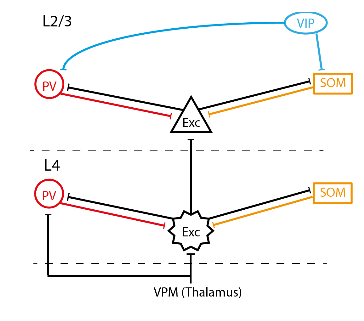

In [32]:
connectivity = mpimg.imread("data/images/connectivity.png")
fig = plt.figure(frameon=False)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(connectivity);

### Coronal slices

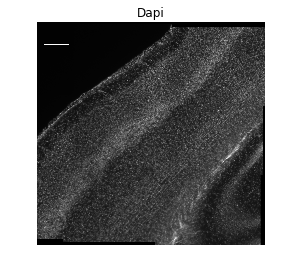

In [33]:
image = tifffile.imread('data/images/TK513/slide2_slice1_epi_dapi_Fused.tif')
pixel_size = 895.26 / 1388 # in um/pixel
bar200um = 200 / pixel_size
plt.figure()
plt.imshow(np.rot90(image[:, 0:3000], 2), cmap='gray')
plt.autoscale(False)
plt.plot([100, bar200um + 100], [300, 300], color='w')
plt.axis('off')
plt.title('Dapi');

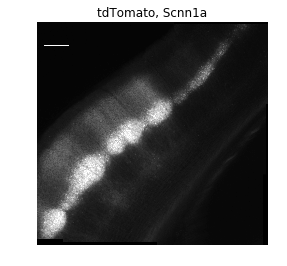

In [34]:
image = tifffile.imread('data/images/TK513/slide2_slice1_epi_tdTomato_Fused.tif')
plt.figure()
plt.imshow(np.rot90(image[:, 0:3000], 2), cmap='gray', vmin=0, vmax=93)
plt.autoscale(False)
plt.plot([100, bar200um + 100], [300, 300], color='w')
plt.axis('off')
plt.title('tdTomato, Scnn1a');

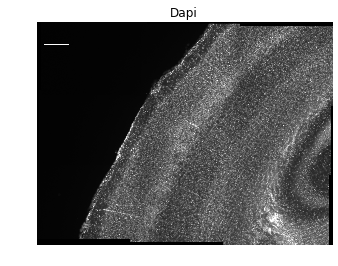

In [35]:
image = tifffile.imread('data/images/TK478/slide1_slice5_epi_dapi_Fused.tif')
plt.figure()
plt.imshow(np.rot90(image, 2), cmap='gray')
plt.autoscale(False)
plt.plot([100, bar200um + 100], [300, 300], color='w')
plt.axis('off')
plt.title('Dapi');

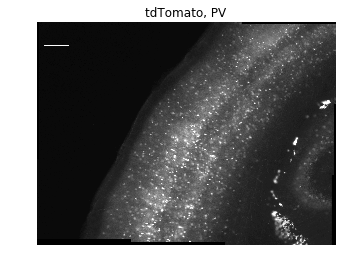

In [36]:
image = tifffile.imread('data/images/TK478/slide1_slice5_epi_tdTomato_Fused.tif')
plt.figure()
plt.imshow(np.rot90(image, 2), cmap='gray', vmin=0, vmax=48)
plt.autoscale(False)
plt.plot([100, bar200um + 100], [300, 300], color='w')
plt.axis('off')
plt.title('tdTomato, PV');

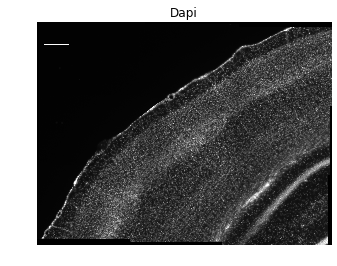

In [37]:
pixel_size = 895.26 / 1388 # in um/pixel
bar200um = 200 / pixel_size

image = tifffile.imread('data/images/TK508/slide3_slice3_epi_dapi_Fused.tif')
plt.figure()
plt.imshow(np.rot90(image, 2), cmap='gray')
plt.autoscale(False)
plt.plot([100, bar200um + 100], [300, 300], color='w')
plt.axis('off')
plt.title('Dapi');

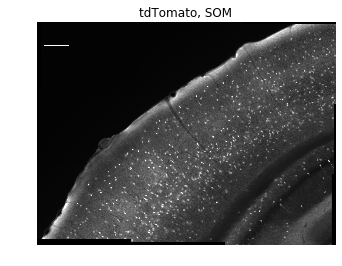

In [38]:
image = tifffile.imread('data/images/TK508/slide3_slice3_epi_tdTomato_Fused.tif')
plt.figure()
plt.imshow(np.rot90(image, 2), cmap='gray')
plt.autoscale(False)
plt.plot([100, bar200um + 100], [300, 300], color='w')
plt.axis('off')
plt.title('tdTomato, SOM');

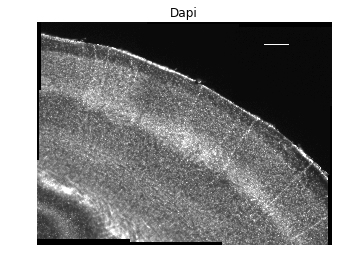

In [39]:
image = tifffile.imread('data/images/TK460/slide2_slice1_epi_dapi_Fused.tif')
plt.figure()
plt.imshow(np.rot90(image, 2), cmap='gray', vmin=0, vmax=48)
plt.autoscale(False)
plt.axis('off')
plt.plot([3000, bar200um + 3000], [300, 300], color='w')
plt.title('Dapi');

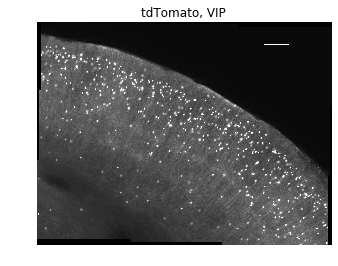

In [40]:
image = tifffile.imread('data/images/TK460/slide2_slice1_epi_tdTomato_Fused.tif')
plt.figure()
plt.imshow(np.rot90(image, 2), cmap='gray', vmin=0, vmax=48)
plt.autoscale(False)
plt.axis('off')
plt.plot([3000, bar200um + 3000], [300, 300], color='w')
plt.title('tdTomato, VIP');

### Tangential slices

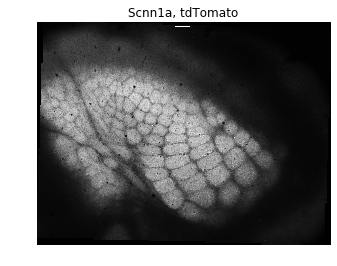

In [41]:
image = tifffile.imread('data/images/TK499/slice7_epi_tdTomato_Fused.tif')
plt.figure()
plt.imshow(image, cmap='gray')
plt.autoscale(False)
plt.axis('off')
pixel_size = 895.26 / 1388 # in um/pixel
bar200um = 200 / pixel_size
plt.plot([3000, bar200um + 3000], [100, 100], color='w')
plt.title('Scnn1a, tdTomato');

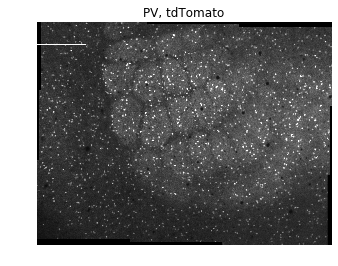

In [42]:
image = tifffile.imread('data/images/TK534/slice4_fused.tif')
plt.figure()
plt.imshow(image, cmap='gray', vmin=0, vmax=47)
plt.autoscale(False)
plt.axis('off')
pixel_size = 447.63 / 1388 # in um/pixel
bar200um = 200 / pixel_size
plt.plot([10, bar200um + 10], [300, 300], color='w')
plt.title('PV, tdTomato');

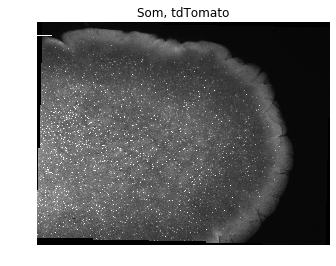

In [43]:
image = tifffile.imread('data/images/TK525/slice6_epi_tdTomato_Fused.tif')
plt.figure()
plt.imshow(image, cmap='gray', vmin=0, vmax=60)
plt.autoscale(False)
plt.axis('off')
pixel_size = 895.26 / 1388 # in um/pixel
bar200um = 200 / pixel_size
plt.plot([10, bar200um + 10], [300, 300], color='w')
plt.title('Som, tdTomato');

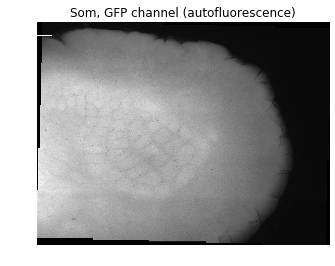

In [44]:
image = tifffile.imread('data/images/TK525/slice6_epi_gfp_Fused.tif')
plt.figure()
plt.imshow(image, cmap='gray')
plt.autoscale(False)
plt.axis('off')
plt.plot([10, bar200um + 10], [300, 300], color='w')
plt.title('Som, GFP channel (autofluorescence)');

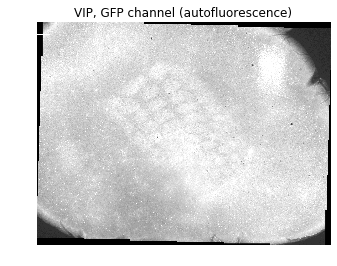

In [45]:
image = tifffile.imread('data/images/TK543/slice5_epi_green_auto.tif')
plt.figure()
plt.imshow(image, cmap='gray', vmin=0, vmax=20)
plt.autoscale(False)
plt.axis('off')
plt.plot([10, bar200um + 10], [300, 300], color='w')
plt.title('VIP, GFP channel (autofluorescence)');

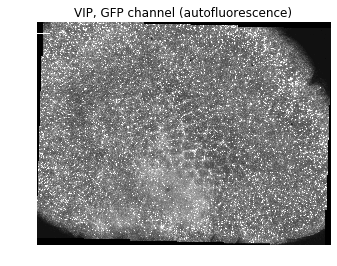

In [46]:
image = tifffile.imread('data/images/TK543/slice5_epi_tdTomato.tif')
plt.figure()
plt.imshow(image, cmap='gray', vmin=0, vmax=30)
plt.autoscale(False)
plt.axis('off')
plt.plot([10, bar200um + 10], [300, 300], color='w')
plt.title('VIP, GFP channel (autofluorescence)');

### Coronal and tangential slices

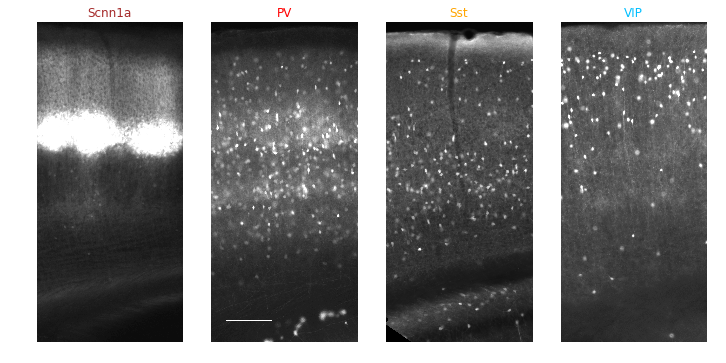

In [47]:
f, axarr = plt.subplots(1, 4, figsize=(12, 8))
image = tifffile.imread('data/images/TK513/slide2_slice1_epi_tdTomato_Fused.tif')
pixel_size = 895.26 / 1388 # in um/pixel
bar200um = 200 / pixel_size
axarr[0].imshow(rotate(image[:, 0:3000], 140)[1120:3320, 1500:2500], cmap='gray', vmin=0, vmax=60)
axarr[0].autoscale(False)
axarr[0].axis('off')
axarr[0].set_title('Scnn1a', color='brown');

image = tifffile.imread('data/images/TK478/slide1_slice5_epi_tdTomato_Fused.tif')
axarr[1].imshow(rotate(image, 120)[1700:3900, 1500:2500], cmap='gray', vmin=0, vmax=48)
axarr[1].autoscale(False)
axarr[1].plot([100, bar200um + 100], [2050, 2050], color='w')
axarr[1].axis('off')
axarr[1].set_title('PV', color='red');

image = tifffile.imread('data/images/TK508/slide3_slice3_epi_tdTomato_Fused.tif')
axarr[2].imshow(rotate(image, 145)[1700:3900, 2000:3000], cmap='gray')
axarr[2].autoscale(False)
axarr[2].axis('off')
axarr[2].set_title('Sst', color='orange');

image = tifffile.imread('data/images/TK460/slide2_slice1_epi_tdTomato_Fused.tif')
axarr[3].imshow(np.fliplr(rotate(image, 200))[1300:3500, 2500:3500], cmap='gray', vmin=0, vmax=48)
axarr[3].autoscale(False)
plt.axis('off')
axarr[3].set_title('VIP', color='deepskyblue');

plt.savefig('coronal_slices.png', dpi=200, bbox_inches='tight')

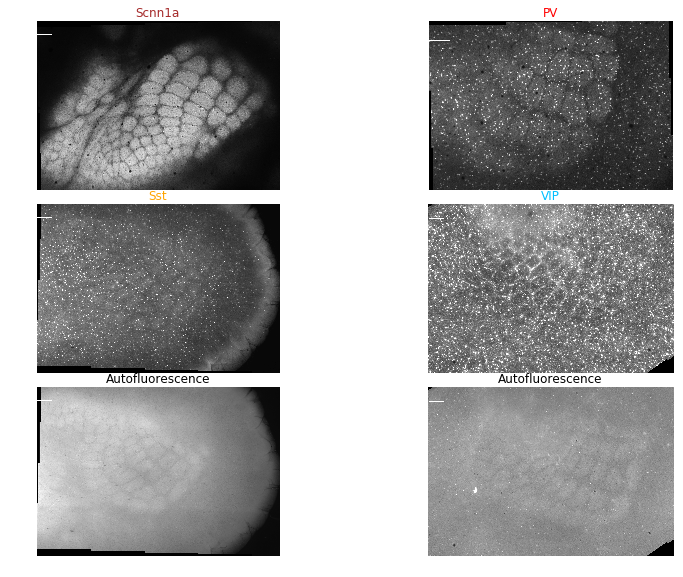

In [48]:
f, axarr = plt.subplots(3, 2, figsize=(10, 9), gridspec_kw=dict(left=0, right=1, top=0.95, hspace=0.08))

image = tifffile.imread('data/images/TK499/slice7_epi_tdTomato_Fused.tif') # this image is inverted (by the upright microscope), the actual slice is not. Seen from the top.
image = image[1000:, 0:5500]
image = np.flipud(image)
axarr[0, 0].imshow(image, cmap='gray')
pixel_size = 895.26 / 1388 # in um/pixel
bar200um = 200 / pixel_size
#plt.plot([3000, bar200um + 3000], [100, 100], color='w')
axarr[0, 0].set_title('Scnn1a', color='brown')

image = tifffile.imread('data/images/TK534/slice4_fused.tif')
axarr[0, 1].imshow(np.flipud(rotate(image, 180)[250:, :]), cmap='gray', vmin=0, vmax=47)
#plt.plot([10, bar200um + 10], [300, 300], color='w')
axarr[0, 1].set_title('PV', color='red')

image = tifffile.imread('data/images/TK525/slice6_epi_tdTomato_Fused.tif')
axarr[1, 0].imshow(image[1000:, 0:5500], cmap='gray', vmin=0, vmax=60)
#plt.plot([10, bar200um + 10], [300, 300], color='w')
axarr[1, 0].set_title('Sst', color='orange');

image = tifffile.imread('data/images/TK543/slice5_epi_tdTomato.tif')
axarr[1, 1].imshow(rotate(image, -145)[2800:6400, 2000:7200], cmap='gray', vmin=0, vmax=30) # this slice imaged from the bottom side
axarr[1, 1].set_title('VIP', color='deepskyblue');

image = tifffile.imread('data/images/TK525/slice6_epi_gfp_Fused.tif')
axarr[2, 0].imshow(image[1000:, 0:5500], cmap='gray')
#plt.plot([10, bar200um + 10], [300, 300], color='w')
axarr[2, 0].set_title('Autofluorescence');

image = tifffile.imread('data/images/TK543/slice5_epi_green_auto.tif')
axarr[2, 1].imshow(rotate(image, -145)[2800:6400, 2000:7200], cmap='gray', vmin=0, vmax=30)
axarr[2, 1].set_title('Autofluorescence');

for axrow in axarr:
    for ax in axrow:
        ax.autoscale(False)
        ax.plot([10, bar200um + 10], [300, 300], color='w')
        ax.axis('off')
plt.savefig('tangential_slices.png', dpi=200, bbox_inches='tight')

### Imaging of whole C2 column

##### utility functions for this section

In [49]:
# use this really?
def prepare_fig():
    fig = plt.figure(figsize=(6.85, 8.5))
    gs1 = gridspec.GridSpec(1, 3, left=0.05, right=1, bottom=0.68, wspace=0, hspace=0)
    ax_l4_large = fig.add_subplot(gs1[0, :-1])
    #ax_l4_large.set_axis_off()
    ax_whisker_pad = fig.add_subplot(gs1[0, -1])
    #ax_whisker_pad.set_axis_off()
    low_bottom = 0.04
    low_top = 0.66
    ax_side_view = fig.add_axes([0.05, low_bottom, 0.3, low_top - low_bottom], )
    ax_side_view.yaxis.tick_right()
    gs2 = gridspec.GridSpec(3, 2, bottom=low_bottom, top=low_top, left=0.4, right=1, hspace=0.03, wspace=0.01)
    return (fig, gs1, ax_l4_large, ax_whisker_pad, ax_side_view, gs2)

#### Preparation of thick slices
1.5 mm tangential slices of the left hemisphere were cut and cleared in CUBIC mount. Bright field and epifluorescence images were obtained.

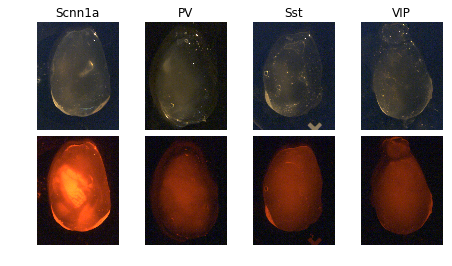

In [51]:
fig, axes = plt.subplots(2, 4, gridspec_kw={'left': 0, 'right': 1, 'wspace': 0, 'hspace':0.05})

mice = ('TK601', 'TK577', 'TK592', 'TK589')
files = (('MC120061.JPG', 'MC120062.JPG'), ('MC120064.JPG', 'MC120065.JPG'), ('MC120071.JPG', 'MC120072.JPG'), ('MC120073.JPG', 'MC120074.JPG'))

i = 0
for m, fpairs in zip(mice, files): 
    for f in fpairs:
        im = mpimg.imread('C:/Users/kiritani/Documents/data/cells/' + m + '/Anatomy/' + f)
        ax = axes[i%2, i//2]
        ax.imshow(np.rot90(im))
        ax.set_axis_off()
        i += 1
        if i%2:
            mouse_lines = ('Scnn1a', 'PV', 'Sst', 'VIP')
            ax.set_title(mouse_lines[i//2]);


Bright field images and then epi images with the new camera. Bf camera settings:
exposure: 96, gain: 73, gamma: 0.5, red: 28, blue: 44, black:0.

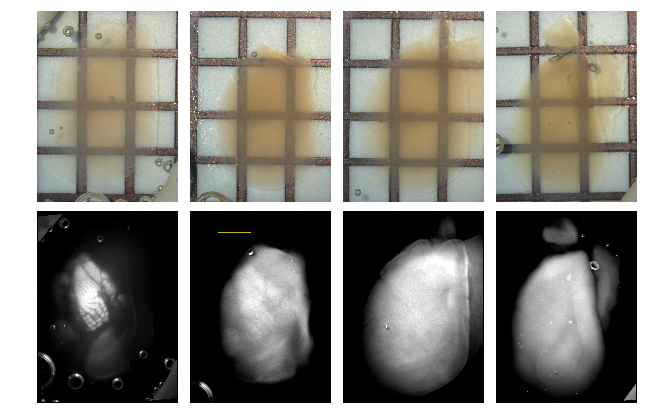

In [53]:
fig, axes = plt.subplots(2, 4, gridspec_kw={'left': 0, 'right': 1, 'wspace': 0, 'hspace':0.05}, figsize=(8.5, 7))

# need to align bright field and fluorescence images from two different cameras. bf images are moved vertically or horizontally.
# fluorescent images are rotated.
im_width, im_height = np.array([1724, 1268]) * scale_factor / .0084818
brains = (('TK601', 'MC120041.JPG', 35, 100, 6, 150, 2000), ('TK607', 'MC120042.JPG', 100, 10, 0, 150, 450), ('TK600', 'MC120040.JPG', 95, 0, 0, 150, 600), ('TK612', 'MC120045.JPG', 0, 75, 5, 150, 450))
for i, b in enumerate(brains):
    im_bright = mpimg.imread('C:/Users/kiritani/Documents/data/cells/' + b[0] + '/Anatomy/' + b[1])
    ax = axes[0, i]
    ax.imshow(np.fliplr(np.transpose(im_bright[b[2]:1368 - 100 + 1 * b[2], b[3]:1824 - 100 + 1 * b[3]], axes=[1, 0, 2])))
    ax.set_axis_off()
    
    im_fluorescent = mpimg.imread('C:/Users/kiritani/Documents/data/cells/' + b[0] + '/Anatomy/whole_hemi_200ms/whole_hemi_200ms_MMStack_Pos0.ome.tif')
    axes[1, i].imshow(np.fliplr(rotate(im_fluorescent, b[4], reshape=False)[0:int(im_height), 0:int(im_width)].T), 'gray', vmin=b[5], vmax=b[6])
                     
    axes[1, i].set_xticks([])
    axes[1, i].set_yticks([])
axes[1, 3].set_xlim(np.array(axes[1, 3].get_xlim()) - 50)
axes[1, 3].set_axis_bgcolor('black')

#axes[1, 0].images[0].set_clim(vmin=10)

img, pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK607/Anatomy/whole_hemi_200ms/whole_hemi_200ms_MMStack_Pos0.ome.tif', z=0, c=0)
pixel_num_for_2mm = 2000 / pixel['x']
axes[1, 1].plot([200, 200 + pixel_num_for_2mm], [150, 150], 'y');

#### L4 barrel organization

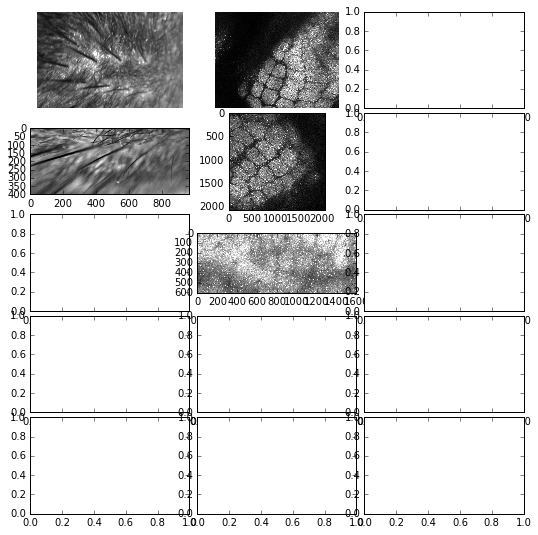

In [54]:
# barrels and whiskers
fig, axes = plt.subplots(5, 3, gridspec_kw={'left': 0, 'right': 1, 'wspace': 0.05, 'hspace':0.05}, figsize=[6.85, 9])
wh_ratio = 1
scnn_whiskers_0, pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK601/Anatomy/whiskers_2/whiskers_2_MMStack_Pos0.ome.tif')
axes[0, 0].imshow(scnn_whiskers_0[0, 500:900, 500:1100], 'gray', vmin=118, vmax=869)
axes[0, 0].set_axis_off()

scnn_barrels_0, pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK601/Anatomy/tile525.czi')
axes[0, 1].imshow(scnn_barrels_0[0,900:2000, 1000:2400], 'gray', )
axes[0, 1].set_axis_off()

scnn_whiskers_1, pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK610/Anatomy/whiskers_1/whiskers_1_MMStack_Pos0.ome.tif')
axes[1, 0].imshow(scnn_whiskers_1[0,300:700, 100:1070], 'gray', vmin=179, vmax=1092)

scnn_barrels_1, pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK610/Anatomy/L4tile.czi')
axes[1, 1].imshow(scnn_barrels_1[0, 500:, 500:], 'gray')

img, pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK577/Anatomy/stack_z_tdtom_400-610.lsm', z=2)
axes[2, 1].imshow(img[0, 1200:1800, 400:2000], 'gray', vmin=0, vmax=27)

plt.savefig("test.tif")

In [3]:
# load L4 images
scnn_barrels, scnn_pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK601/Anatomy/tile525.czi')
pv_barrels, pv_pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK606/Anatomy/tdtom_tile_604.lsm')
sst_barrels, sst_pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK600/Anatomy/tdtom_tile_430um_large.lsm')
sst_barrels_g, sst_pixel_g = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK600/Anatomy/green_tile_430um_large.lsm')
vip_barrels, vip_pixel = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK618/Anatomy/tdtom_tile_480.lsm')
vip_barrels_g, vip_pixel_g = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK618/Anatomy/green_tile_480_0.lsm')

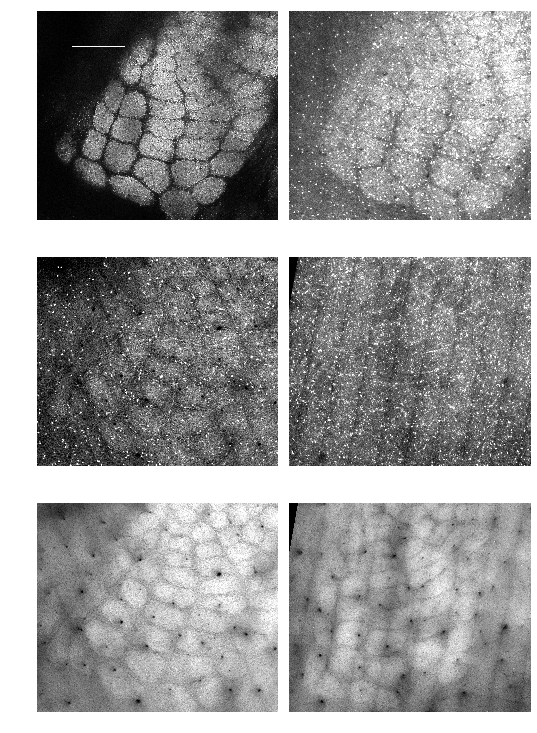

In [16]:
# L4 tiles
fig, axes = plt.subplots(3, 2, gridspec_kw={'left': 0, 'right': 1, 'wspace': 0.05, 'hspace':0.05}, figsize=[6.85, 13])

height = 2000 # in um
width = 2300 # in um

axes[0, 0].imshow(rotate(scnn_barrels, 5, axes=(1, 2))[0, 1200:1200 + int(height / scnn_pixel['x']), 1300:1300 + int(width / scnn_pixel['y'])], 'gray', )
axes[0, 0].autoscale(False)
axes[0, 0].plot([200, 200 + 500/scnn_pixel['x']], [200, 200], color='white')
axes[0, 0].set_axis_off()

axes[0, 1].imshow(pv_barrels[0, 0:int(height / pv_pixel['x']), 0:int(width / pv_pixel['y'])], 'gray', vmax=120)
axes[0, 1].set_axis_off()

axes[1, 0].imshow(rotate(sst_barrels, 25, axes=(1, 2))[0, 1000:1000 + int(height / sst_pixel['x']), 900:900 + int(width / sst_pixel['y'])], cmap='gray', vmin=30, vmax=103)
axes[1, 0].set_axis_off()

axes[2, 0].imshow(rotate(sst_barrels_g, 25, axes=(1, 2))[0, 1000:1000 + int(height / sst_pixel_g['x']), 900:900 + int(width / sst_pixel_g['y'])], cmap='gray', vmin=42, vmax=113)
axes[2, 0].set_axis_off()

axes[1, 1].imshow(rotate(vip_barrels, -10, axes=(1, 2))[0, 600:600 + int(height / vip_pixel['x']), 300:300 + int(width / vip_pixel['y'])], cmap='gray', vmin=27, vmax=71)
axes[1, 1].set_axis_off()

axes[2, 1].imshow(rotate(vip_barrels_g, -10, axes=(1, 2))[0, 600:600 + int(height / vip_pixel_g['x']), 300:300 + int(width / vip_pixel_g['y'])], cmap='gray', vmin=47, vmax=87)
axes[2, 1].set_axis_off()

#### Image stacks

In [27]:
# convert stacks to movies
def stack2movie(stack, voxel_size, pia=0, text_position=None, contrast=(1, 99), scale_bar_position=None, interval=500):
    """Converts an image stack to a movie. The first dimension of the stack is for z."""
    fig, ax = plt.subplots(figsize=(15, 10), dpi=300)
    ax.set_position([0, 0, 1, 1])
    ax.set_axis_off()
    im = ax.imshow(stack[0, :, :], 'gray')
    ax.set_autoscale_on(False)
    w, h = stack[0].shape
    
    if text_position is None:
        text_position = (0.8 * h, 0.78 * w)        
    tx = ax.text(*text_position, '', color='r', ha='left', size=20)
    
    if scale_bar_position is None:
        scale_bar_position = (0.8 * h, 0.9 * w)
    scale_x = (scale_bar_position[0], scale_bar_position[0] + 50 / voxel_size['x'])
    scale_y = (scale_bar_position[1], scale_bar_position[1])
    scale_bar = ax.plot(scale_x, scale_y, 'r')
    tx_bar = ax.text(np.mean(scale_x), scale_y[0] + 5, '50 um', ha='center', va='top', color='r', size=15)
    def init():
        im.set_data(stack[0, :, :])
        return [im]

    def animate(i):
        im.set_array(stack[i, :, :])
        im.set_clim(vmin=np.percentile(stack[i, :, :], contrast[0]), vmax=np.percentile(stack[i, :, :], contrast[1]))
        tx.set_text('d={0:.1f} um'.format((i - pia) * voxel_size['z']))
        return [im]

    anim = animation.FuncAnimation(fig, animate, init_func=init, frames=stack.shape[0], interval=interval, blit=False)
    return anim

stacks = (('C:/Users/kiritani/Documents/data/cells/TK566/Anatomy/stack_tdtom.lsm', 16),
          ('C:/Users/kiritani/Documents/data/cells/TK601/Anatomy/stack0-1276p91.czi', 8),
          ('C:/Users/kiritani/Documents/data/cells/TK610/Anatomy/stack_tdtom.czi', 2),
          ('C:/Users/kiritani/Documents/data/cells/TK577/Anatomy/stack_tdtom.tif', 31),
          ('C:/Users/kiritani/Documents/data/cells/TK578/Anatomy/Concatenated Stacks.tif', 43),
          ('C:/Users/kiritani/Documents/data/cells/TK579/Anatomy/stack_tdtom.lsm', 17),
          ('C:/Users/kiritani/Documents/data/cells/TK606/Anatomy/stack_tdtom.lsm', 5),
          ('C:/Users/kiritani/Documents/data/cells/TK607/Anatomy/stack_tdtom.czi', 5),
          ('C:/Users/kiritani/Documents/data/cells/TK594/Anatomy/stack_tdtom.czi', 17),
          ('C:/Users/kiritani/Documents/data/cells/TK595/Anatomy/stack_tdtom0-1400p18.czi', 18),
          ('C:/Users/kiritani/Documents/data/cells/TK600/Anatomy/stack_tdtom.czi', 19),
          ('C:/Users/kiritani/Documents/data/cells/TK618/Anatomy/stack_tdtom.lsm', 12),
          ('C:/Users/kiritani/Documents/data/cells/TK619/Anatomy/stack_tdtom_neg25-1820p43.lsm', 10),
          ('C:/Users/kiritani/Documents/data/cells/TK622/Anatomy/stack_tdtom.lsm', 13),
         )

for stack in stacks:
    m = re.search('TK[\d]{3}', stack[0])
    mouse_name = m.group(0)
    z = -1
    if mouse_name == 'TK601':
        z = range(385) # acquisition was terminated in hippocampus
    img, voxel = load_bioformats_img(stack[0], c=0, z=z)
    if mouse_name =='TK607':
        img = img.T
    anim = stack2movie(img, voxel, pia=stack[1], interval=500)
    anim.save(mouse_name + '.mp4', writer='ffmpeg', bitrate=30000, dpi=300, codec='libx264') # bitrate unit seems to be kbs
    plt.close();

AttributeError: 'str' object has no attribute 'T'

##### Scnn1a

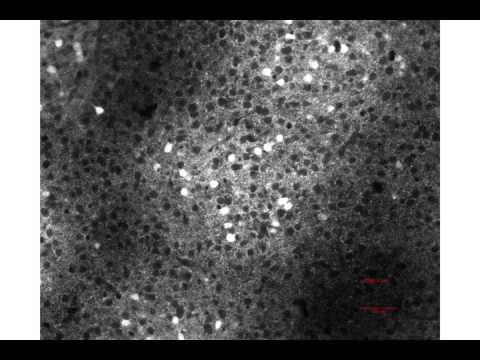

In [8]:
YouTubeVideo('E2Wwe2rwwlw')

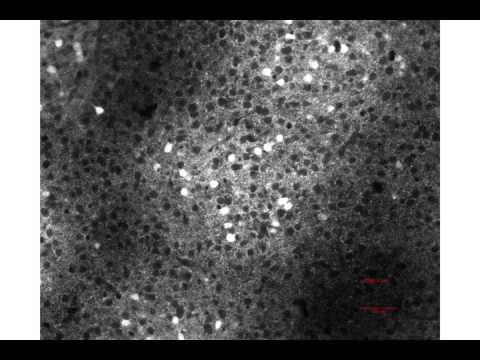

In [9]:
YouTubeVideo('mIJht92wB-k')

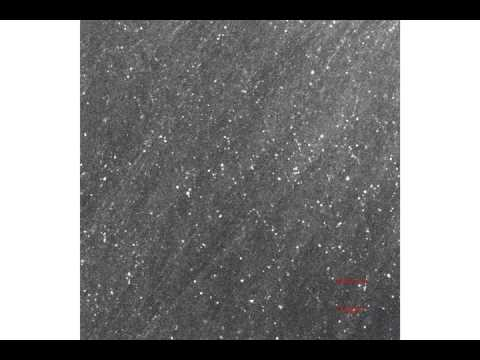

In [6]:
YouTubeVideo('W2fsT0396ls')

##### PV

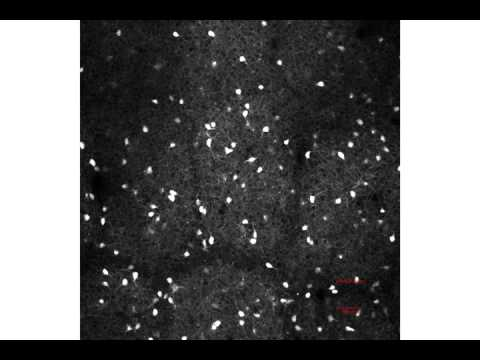

In [7]:
YouTubeVideo('eiYm6DIweHY')

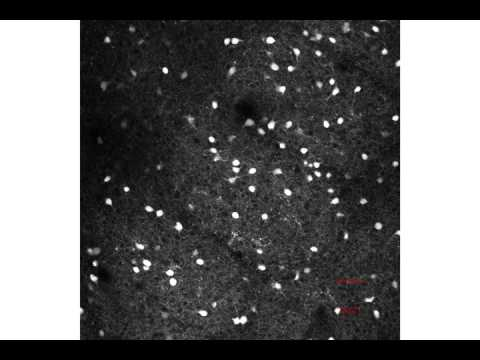

In [10]:
YouTubeVideo('q7YVIQqBrgw')

In [11]:
YouTubeVideo('CMcbGoynBmw')

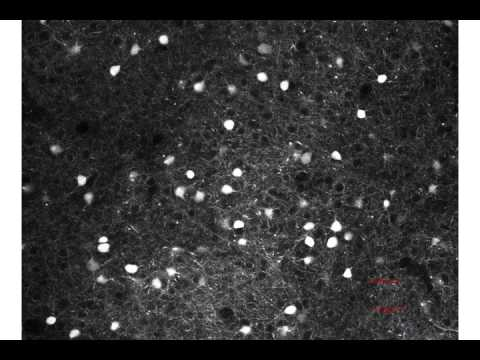

In [12]:
YouTubeVideo('yujnHC5vWd0')

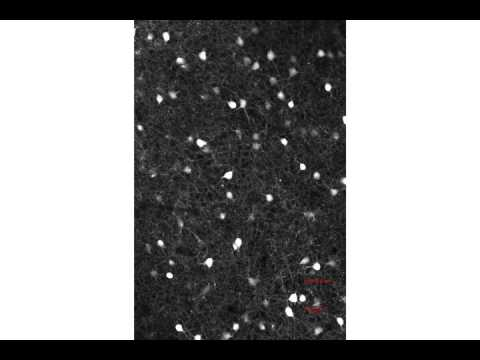

In [13]:
YouTubeVideo('7u1_q1-hbXk')

##### Sst

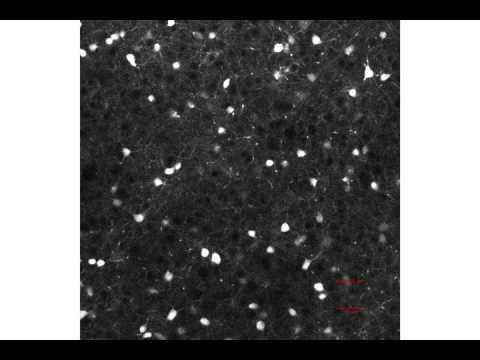

In [14]:
YouTubeVideo('E3_9KILXYgE')

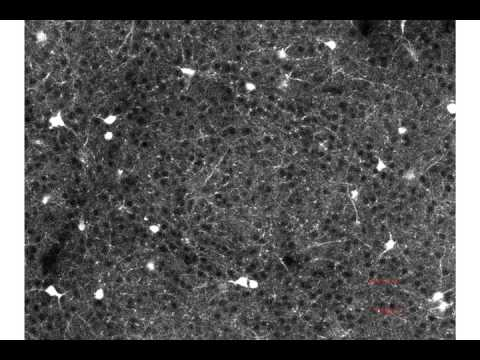

In [15]:
YouTubeVideo('YeeKDUjIRco')

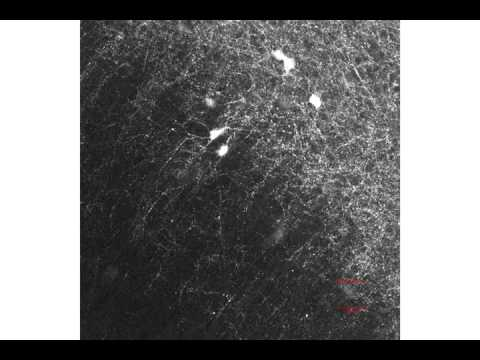

In [28]:
YouTubeVideo('anGXcU6DTLc')

##### VIP

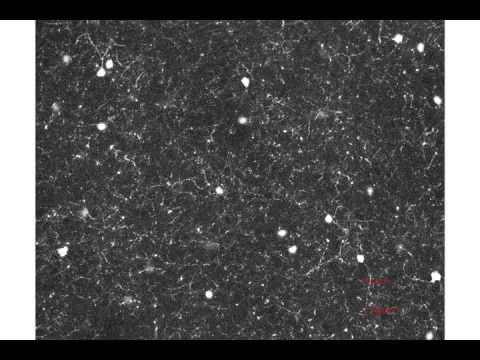

In [29]:
YouTubeVideo('IvBud6W8GcM')

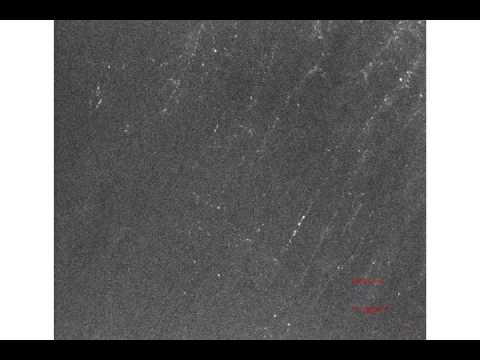

In [31]:
YouTubeVideo('XHBSAzN1AZ0')

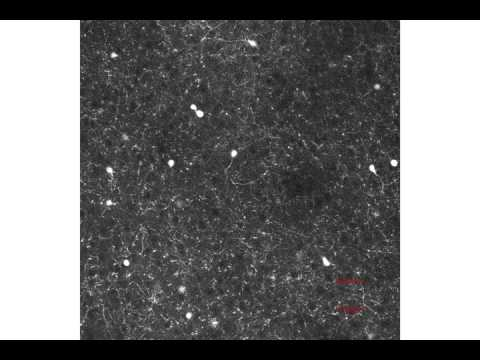

In [30]:
YouTubeVideo('0iqsX4LVrmU')

#### Cell distribution in 3d

In [17]:
def preprocess_3d(image_path, barrel_offset_in_um=0, barrel_image_path=None):
    '''converts rois to coordinates. Neurons.zip, Pia.zip, Bottom.zip, and Barrel.zip should be in the same folder as image_path'''
    import xml.etree.ElementTree as ET
    
    neurons_path = os.path.dirname(image_path) + '/Neurons.zip'
    pia_path = os.path.dirname(image_path) + '/Pia.zip'
    bottom_path = os.path.dirname(image_path) + '/Bottom.zip'
    barrel_path = os.path.dirname(image_path) + '/Barrel.zip'
    
    root = ET.fromstring(bioformats.get_omexml_metadata(path=image_path))
    nsmap = {'n': 'http://www.openmicroscopy.org/Schemas/OME/2015-01'}
    voxel = root.find('n:Image', namespaces=nsmap).find('n:Pixels', namespaces=nsmap)
    voxel_vector = np.array([[float(voxel.get('PhysicalSizeX'))], [float(voxel.get('PhysicalSizeY'))], [-1 * float(voxel.get('PhysicalSizeZ'))]])
    
    xyz = []
    for path in [neurons_path, pia_path, bottom_path]:
        rois = ijroi.read_roi_zip(path)
        xyz_in_pixel = [(roi[1].points[0][0], roi[1].points[0][1], roi[1].position)  for roi in rois]
        xyz.append(np.transpose(xyz_in_pixel) * voxel_vector)
    neurons_xyz, pia_xyz, bottom_xyz = xyz
    
    if barrel_image_path:
        root = ET.fromstring(bioformats.get_omexml_metadata(path=barrel_image_path))
        voxel = root.find('n:Image', namespaces=nsmap).find('n:Pixels', namespaces=nsmap)
        voxel_vector = np.array([[float(voxel.get('PhysicalSizeX'))], [float(voxel.get('PhysicalSizeY'))], [-1 * float(voxel.get('PhysicalSizeZ'))]])
    
    rois = ijroi.read_roi_zip(barrel_path)
    barrel_xyz_in_pixel = [(roi[1].points[0][0], roi[1].points[0][1], roi[1].position)  for roi in rois]
    barrel_xyz = np.transpose(barrel_xyz_in_pixel) * voxel_vector
    barrel_xyz = barrel_xyz + np.array([[0], [0], [barrel_offset_in_um]])
    
    return (neurons_xyz, pia_xyz, bottom_xyz, barrel_xyz)

In [18]:
def c2_3d(neurons_xyz, pia_xyz, bottom_xyz, barrel_xyz, init_xyz):
    from matplotlib.patches import Polygon
    from matplotlib.path import Path
    from scipy.interpolate import LinearNDInterpolator
    import plotly
    from plotly.graph_objs import Data, Figure, Layout, Line, Surface, Mesh3d, Scatter3d
    from datetime import datetime
    def make_flat_pia(x_pia, y_pia, z_pia, a, b, c):
        """make a plotly 3d plane (ax + by + z + c = 0) that minimized the sum of distance from the pia surface. needs to provide the first estimate"""
        from scipy import optimize
        points = [*np.meshgrid(x_pia, y_pia), z_pia]
        points = list(map(lambda x: x.flatten(), points))
        points = np.reshape(np.transpose(points), (-1, 3))
        
        def distance2plane(terms):
            """calculate the sum of distance from points to a plane ax + by + z + c = 0 (here, I know the term for z is not zero.)
            initial values for a, b, c are provided in terms as a tuple.
            """
            abc = np.append(terms[:2], 1)
            return np.sum([np.abs(np.sum(abc * np.array(point)) + terms[2]) / np.sqrt((abc**2).sum()) for point in points])
        
        def pia_flat_plane(x, y, a, b, c):
            return -1 * c - a * x - b * y
        
        result = optimize.minimize(distance2plane, [a, b, c])
        x_pia_flat = [x_pia.min(), x_pia.max()]
        y_pia_flat = [y_pia.min(), y_pia.max()]
        x_pia_flat_mesh, y_pia_flat_mesh = np.meshgrid(x_pia_flat, y_pia_flat)
        z_pia_flat = np.reshape([pia_flat_plane(*xy, *result.x) for xy in zip(x_pia_flat_mesh.flatten(), y_pia_flat_mesh.flatten())], (2,2))
        pia_flat = Surface(x=x_pia_flat, y=y_pia_flat, z=z_pia_flat, opacity=0.8, showscale=False)
        return (result, pia_flat)
    
    def outline_barrel(points):
        from scipy.spatial import ConvexHull
        import pandas as pd
        hull = ConvexHull(points)
        inner_points = set(range(len(points))) - set(hull.vertices)
        simplices = hull.simplices
        
        def dist_simplice_to_point(simplice, point):
            cross_p = np.cross(points[simplice[1]] - points[simplice[0]], points[simplice[2]] - points[simplice[0]])
            cross_p = cross_p / np.linalg.norm(cross_p)
            d = np.abs(np.inner(cross_p, points[point] - points[simplice[0]]))
            a = np.vstack([points[simplice[1]] - points[simplice[0]], points[simplice[2]] - points[simplice[0]], cross_p])
            b = points[point] - points[simplice[0]]
            x = np.linalg.solve(a.T, b) # x[2] should be equal to d
            if 0<x[0]<1 and 0<x[1]<1 and x[0] + x[1]<1:
                return d
            else:
                return None
        
        simplices = list(map(tuple, simplices))
        df = pd.DataFrame(index=simplices, columns=inner_points)
        for column in df.columns:
            #for index in df.index:
            df[column] = list(map(lambda x: dist_simplice_to_point(x, column), df.index))
            #    df[column][index] = dist_simplice_to_point(index, column)
        while df.shape[1]:
            min_df = df.min().min()
            if np.isnan(min_df):
                break
            closest_simplice, closest_inner_point = df[df==min_df].stack().index.tolist()[0]
            
            new_faces = (np.append(closest_simplice[0:2], closest_inner_point),
                        np.append(closest_simplice[0::2], closest_inner_point),
                        np.append(closest_simplice[1::], closest_inner_point))
            new_faces = list(map(tuple, new_faces))
            df.drop(closest_inner_point, 1, inplace=True)
            df.drop(closest_simplice, 0, inplace=True)
            new_df = pd.DataFrame(index=new_faces, columns=df.columns)
            #for column in new_df.columns:
            #    for index in new_df.index:
            #        new_df[column][index] = dist_simplice_to_point(index, column)
            for index in new_df.index:
                new_df.loc[index] = list(map(lambda x: dist_simplice_to_point(index,x), new_df.columns))
            df = pd.concat([df, new_df])
            #for simplice in new_faces:
            #    df.loc[simplice] = list(map(lambda x: dist_simplice_to_point(simplice, x), df.columns))
        print(df.shape[1])
        hull.simplices = list(map(list, df.index))
        return hull

    def plotly_trisurf(x, y, z, simplices, plot_edges=None):
        from functools import reduce
    
        points3D = np.vstack((x,y,z)).T
        tri_vertices = list(map(lambda index: points3D[index], simplices))# vertices of the surface triangles  
        I, J, K = ([triplet[c] for triplet in simplices] for c in range(3))
        triangles = Mesh3d(x=x, y=y, z=z, i=I, j=J, k=K, name='', opacity=0.2, )
    
        if plot_edges is None:
            return Data([triangles])
        else:
            #None separates data corresponding to two consecutive triangles
            lists_coord = [[[T[k%3][c] for k in range(4)]+[ None] for T in tri_vertices]  for c in range(3)]
            Xe, Ye, Ze  = [reduce(lambda x,y: x+y, lists_coord[k]) for k in range(3)]
            lines = Scatter3d(x=Xe, y=Ye, z=Ze, mode='lines', line=Line(color= 'rgb(50,50,50)', width=1.5))
        return Data([triangles, lines])


    pia_interpolator = LinearNDInterpolator(pia_xyz[0:2].T, np.asarray(pia_xyz[2]))
    pia_func = np.vectorize(pia_interpolator)
    x_pia = np.arange(pia_xyz[0].min() + 10, pia_xyz[0].max() - 10, 10)
    y_pia = np.arange(pia_xyz[1].min() + 10, pia_xyz[1].max() - 10, 10)
    z_pia = pia_func(*np.meshgrid(x_pia, y_pia))
    result, pia_flat = make_flat_pia(x_pia, y_pia, z_pia, *init_xyz)
    
    normal_vector = np.append(result.x[:2], 1)
    theta_z = np.arctan2(normal_vector[1], normal_vector[0]) * -1
    theta_y = np.arctan2(np.sqrt(normal_vector[0]**2 + normal_vector[1]**2), normal_vector[2]) * -1
    rot_z = np.mat([[np.cos(theta_z), -1 * np.sin(theta_z), 0], [np.sin(theta_z), np.cos(theta_z), 0], [0, 0, 1]])
    rot_y = np.mat([[np.cos(theta_y), 0, np.sin(theta_y)], [0, 1, 0], [-1 * np.sin(theta_y), 0, np.cos(theta_y)]])
    rot_mat = np.transpose(rot_z) * rot_y * rot_z

    pia_xyz_rotated = rot_mat * pia_xyz
    pia_rotated_interpolator = LinearNDInterpolator(pia_xyz_rotated[0:2].T, np.asarray(pia_xyz_rotated[2]).squeeze())
    pia_rotated_func = np.vectorize(pia_rotated_interpolator)
    x_pia_rotated = np.arange(pia_xyz_rotated[0].min(), pia_xyz_rotated[0].max(), 5)
    y_pia_rotated = np.arange(pia_xyz_rotated[1].min(), pia_xyz_rotated[1].max(), 5)
    z_pia_rotated = pia_rotated_func(*np.meshgrid(x_pia_rotated, y_pia_rotated))
    pia_rotated = Surface(x=x_pia_rotated, y=y_pia_rotated, z=z_pia_rotated, opacity=0.8, showscale=False)

    bottom_xyz_rotated = rot_mat * bottom_xyz
    bottom_interpolator = LinearNDInterpolator(bottom_xyz_rotated[0:2].T, np.asarray(bottom_xyz_rotated[2]).squeeze())
    bottom_rotated_func = np.vectorize(bottom_interpolator)
    
    x_bottom_rotated = np.arange(bottom_xyz_rotated[0].min(), bottom_xyz_rotated[0].max(), 5)
    y_bottom_rotated = np.arange(bottom_xyz_rotated[1].min(), bottom_xyz_rotated[1].max(), 5)
    z_bottom_rotated = bottom_rotated_func(*np.meshgrid(x_bottom_rotated, y_bottom_rotated))
    bottom_rotated = Surface(x=x_bottom_rotated, y=y_bottom_rotated, z=z_bottom_rotated, opacity=0.8, showscale=False)
    
    barrel_xyz_rotated = np.asarray(rot_mat * barrel_xyz)
    hull = outline_barrel(barrel_xyz_rotated.T)
    barrel_vol = plotly_trisurf(*barrel_xyz_rotated, hull.simplices, plot_edges=None)

    neurons_xyz_rotated = np.asarray(rot_mat * neurons_xyz)
    
    triangles = []
    for face in hull.simplices:
        triangle_vertices = barrel_xyz_rotated.T[face]
        triangles.append({'path': Path(triangle_vertices[[0, 1, 2, 0], 0:2]), 'vertices': triangle_vertices})
        
    neurons = [{'position': neuron, 'in_c2': False, 'upper_L4': -1000, 'bottom_L4': 0, 'depth': 0} for neuron in neurons_xyz_rotated.T]
    
    for neuron in neurons:
        for triangle in triangles:
            if triangle['path'].contains_point(neuron['position'][0:2]):
                neuron['in_c2'] = True
                cp = np.cross(triangle['vertices'][0] - triangle['vertices'][2], triangle['vertices'][1] - triangle['vertices'][2])
                depth_triangle_at_this_xy = (np.inner(cp, triangle['vertices'][0]) - cp[0] * neuron['position'][0] - cp[1] * neuron['position'][1])/cp[2]
                neuron['upper_L4'] = max(depth_triangle_at_this_xy, neuron['upper_L4'])
                neuron['bottom_L4'] = min(depth_triangle_at_this_xy, neuron['bottom_L4'])
        neuron['depth'] = neuron['position'][2] - pia_rotated_func(*neuron['position'][0:2])
        neuron['dist_to_white_matter'] = neuron['position'][2] - bottom_rotated_func(*neuron['position'][0:2])
        
    nonc2neurons = [neuron for neuron in neurons if not neuron['in_c2']]
    c2neurons = [neuron for neuron in neurons if neuron['in_c2']]
    l23neurons = [neuron for neuron in c2neurons if neuron['upper_L4'] < neuron['position'][2]]
    l4neurons = [neuron for neuron in c2neurons if neuron['upper_L4'] > neuron['position'][2] > neuron['bottom_L4']]
    l56neurons = [neuron for neuron in c2neurons if neuron['bottom_L4'] > neuron['position'][2]]
    neurons = {'non_c2': nonc2neurons, 'l23_c2': l23neurons, 'l4_c2': l4neurons, 'l56_c2': l56neurons}
    neurons_scattered = []
    for specific_neurons in [nonc2neurons, l23neurons, l4neurons, l56neurons]:
        x = [n['position'][0] for n in specific_neurons]
        y = [n['position'][1] for n in specific_neurons]
        z = [n['position'][2] for n in specific_neurons]
        neurons_scattered.append(Scatter3d(x=x, y=y, z=z, opacity=0.7, marker={'size': 2}, mode='markers'))
    data = [pia_rotated, bottom_rotated] + barrel_vol + neurons_scattered
    layout = Layout(margin=dict(l=0, r=0, b=0, t=0), scene=dict(aspectmode='data'),
                       autosize=False, width=600, height=600,)
    fig = Figure(data=data, layout=layout)
    
    plotly.offline.iplot(fig,)
    
    return neurons

In [20]:
# 3d plotting of tdtom neurons
PV_stacks = \
    ({'image_path': 'C:/Users/kiritani/Documents/data/cells/TK577/Anatomy/stack_tdtom.tif'
     },
     {'image_path': 'C:/Users/kiritani/Documents/data/cells/TK578/Anatomy/Concatenated Stacks.tif'
     },
     {'image_path': 'C:/Users/kiritani/Documents/data/cells/TK579/Anatomy/stack_tdtom.lsm'
     },
     {'image_path': 'C:/Users/kiritani/Documents/data/cells/TK606/Anatomy/stack_tdtom.lsm'
     },
     {'image_path': 'C:/Users/kiritani/Documents/data/cells/TK607/Anatomy/stack_tdtom.czi'
     })

Sst_stacks = \
    ({'image_path': 'C:/Users/kiritani/Documents/data/cells/TK594/Anatomy/stack_tdtom.czi'
     , 'barrel_offset_in_um': -415,
     'barrel_image_path': 'C:/Users/kiritani/Documents/data/cells/TK594/Anatomy/green_415-590.czi'
     },
     {'image_path': 'C:/Users/kiritani/Documents/data/cells/TK595/Anatomy/stack_tdtom0-1400p18.czi'
     , 'barrel_offset_in_um': -480,
     'barrel_image_path': 'C:/Users/kiritani/Documents/data/cells/TK595/Anatomy/stack_z_480-620_green.czi'
     },
     {'image_path': 'C:/Users/kiritani/Documents/data/cells/TK600/Anatomy/stack_tdtom.czi'
     , 'barrel_offset_in_um': -422.45,
     'barrel_image_path': 'C:/Users/kiritani/Documents/data/cells/TK600/Anatomy/green_stack_422p45-592p45.czi'
     })

Vip_stacks = \
    ({'image_path': 'C:/Users/kiritani/Documents/data/cells/TK618/Anatomy/stack_tdtom.lsm'
     , 'barrel_offset_in_um': -448.15,
     'barrel_image_path': 'C:/Users/kiritani/Documents/data/cells/TK618/Anatomy/green_448p15-598p15.lsm'
     },
     {'image_path': 'C:/Users/kiritani/Documents/data/cells/TK619/Anatomy/stack_tdtom_neg25-1820p43.lsm'
     , 'barrel_offset_in_um': -395 - 25,
     'barrel_image_path': 'C:/Users/kiritani/Documents/data/cells/TK619/Anatomy/green_395-650.lsm'
     },
     {'image_path': 'C:/Users/kiritani/Documents/data/cells/TK622/Anatomy/stack_tdtom.lsm'
     , 'barrel_offset_in_um': -420,
     'barrel_image_path': 'C:/Users/kiritani/Documents/data/cells/TK622/Anatomy/green_z_420p1-640p1.lsm'
     })

PV_init_xyzs = ((0, 0, 50), (0, 0, 180), (0, 0, 50), (0, 0, 20), (0, 0,
                10))
Sst_init_xyzs = ((0, 0, 30), (0, 0, 60), (0, 0, 53))
Vip_init_xyzs = ((0, 0, 30), (0, 0, 23), (0, 0, 12))

PV_brains = []
for (stack, init_xyz) in zip(PV_stacks, PV_init_xyzs):
    (neurons_xyz, pia_xyz, bottom_xyz, barrel_xyz) = \
        preprocess_3d(**stack)
    PV_brains.append(c2_3d(neurons_xyz, pia_xyz, bottom_xyz,
                     barrel_xyz, init_xyz))

Sst_brains = []
for (stack, init_xyz) in zip(Sst_stacks, Sst_init_xyzs):
    (neurons_xyz, pia_xyz, bottom_xyz, barrel_xyz) = \
        preprocess_3d(**stack)
    Sst_brains.append(c2_3d(neurons_xyz, pia_xyz, bottom_xyz,
                      barrel_xyz, init_xyz))

Vip_brains = []
for (stack, init_xyz) in zip(Vip_stacks, Vip_init_xyzs):
    (neurons_xyz, pia_xyz, bottom_xyz, barrel_xyz) = \
        preprocess_3d(**stack)
    Vip_brains.append(c2_3d(neurons_xyz, pia_xyz, bottom_xyz,
                      barrel_xyz, init_xyz))

0


0


1


0


2


0


0


1


0


0


1


Number of PV in C2: [375, 426, 453, 491, 374]
Number of Sst in C2: [288, 302, 270]
Number of VIP in C2: [135, 121, 136]
Or,
423.8 +- 45.2
286.7 +- 13.1
130.7 +- 6.8


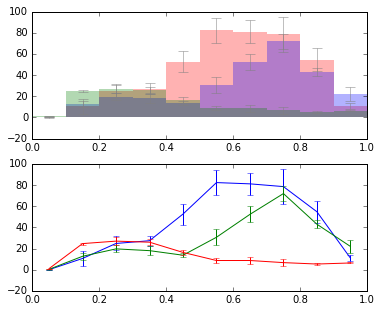

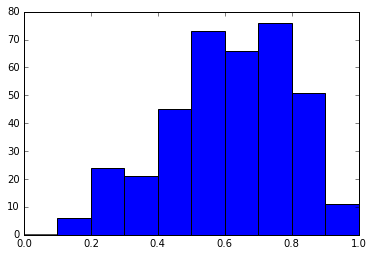

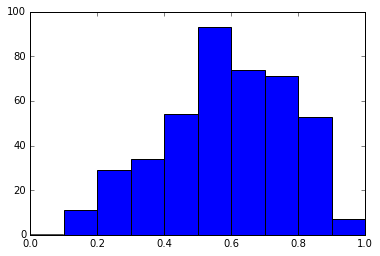

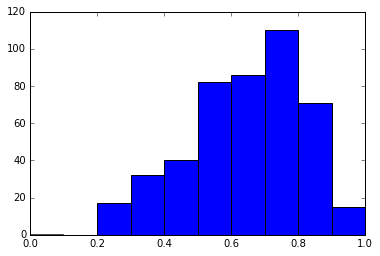

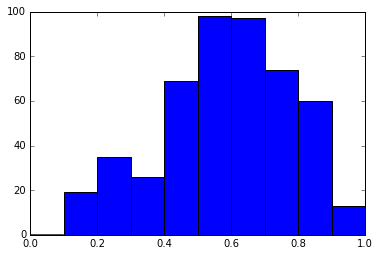

...

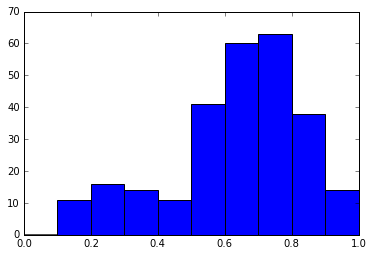

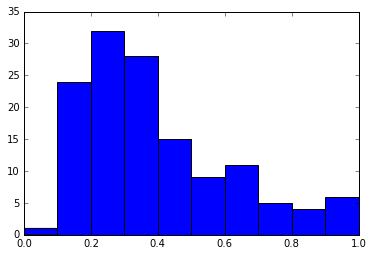

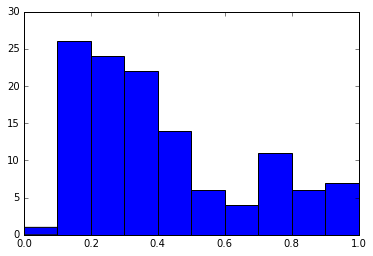

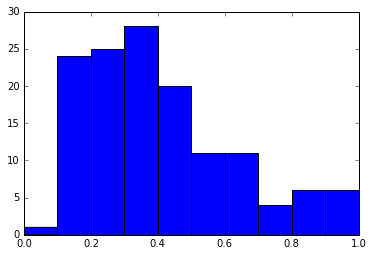

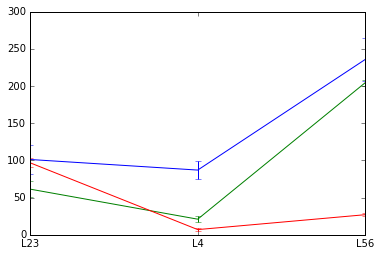

In [22]:
# quantify neurons in C2
def get_c2_neurons_depth(brain):
    c2_neurons = brain['l23_c2'] + brain['l4_c2'] + brain['l56_c2']
    depths = [-neuron['depth'] for neuron in c2_neurons]
    normalized_depths = [-neuron['depth']
                         / (neuron['dist_to_white_matter']
                         - neuron['depth']) for neuron in c2_neurons]
    return (depths, normalized_depths)


def get_num_of_C2_neurons(brain):
    c2_neurons = brain['l23_c2'] + brain['l4_c2'] + brain['l56_c2']
    return len(c2_neurons)


print('Number of PV in C2: {}'.format([get_num_of_C2_neurons(brain)
        for brain in PV_brains]))
print('Number of Sst in C2: {}'.format([get_num_of_C2_neurons(brain)
        for brain in Sst_brains]))
print('Number of VIP in C2: {}'.format([get_num_of_C2_neurons(brain)
        for brain in Vip_brains]))
print('Or,')
print('{0:.1f} +- {1:.1f}'.format(np.mean([get_num_of_C2_neurons(brain)
                                  for brain in PV_brains]),
                                  np.std([get_num_of_C2_neurons(brain)
                                  for brain in PV_brains])))
print('{0:.1f} +- {1:.1f}'.format(np.mean([get_num_of_C2_neurons(brain)
                                  for brain in Sst_brains]),
                                  np.std([get_num_of_C2_neurons(brain)
                                  for brain in Sst_brains])))
print('{0:.1f} +- {1:.1f}'.format(np.mean([get_num_of_C2_neurons(brain)
                                  for brain in Vip_brains]),
                                  np.std([get_num_of_C2_neurons(brain)
                                  for brain in Vip_brains])))

(fig, ax) = plt.subplots(2, figsize=(6, 5))
mouselines = [PV_brains, Sst_brains, Vip_brains]
for (mouseline, color) in zip([PV_brains, Sst_brains, Vip_brains], ['r'
                              , 'b', 'g']):
    dist_neurons = []
    for brain in mouseline:
        (depths, normalized_depths) = get_c2_neurons_depth(brain)
        plt.figure()
        dist_neurons.append(plt.hist(normalized_depths, bins=10,
                            range=(0, 1))[0])
    neurons_mean = np.mean(dist_neurons, 0)
    neurons_std = np.std(dist_neurons, 0)
    ax[0].bar(
        left=np.arange(0, 1, 0.1),
        height=neurons_mean,
        yerr=neurons_std,
        width=0.1,
        alpha=.3,
        color=color,
        linewidth=0,
        error_kw=dict(ecolor='gray', lw=0.5, capsize=5, capthick=0.5),
        )
    ax[1].errorbar(np.arange(0.05, 1, 0.1), neurons_mean,
                   yerr=neurons_std)

pv_layers = np.vstack(([len(brain['l23_c2']) for brain in PV_brains],
                      [len(brain['l4_c2']) for brain in PV_brains],
                      [len(brain['l56_c2']) for brain in PV_brains]))
sst_layers = np.vstack(([len(brain['l23_c2']) for brain in Sst_brains],
                       [len(brain['l4_c2']) for brain in Sst_brains],
                       [len(brain['l56_c2']) for brain in Sst_brains]))
vip_layers = np.vstack(([len(brain['l23_c2']) for brain in Vip_brains],
                       [len(brain['l4_c2']) for brain in Vip_brains],
                       [len(brain['l56_c2']) for brain in Vip_brains]))
(fig, ax) = plt.subplots()
ax.errorbar([0, 1, 2], pv_layers.mean(1), yerr=pv_layers.std(1))
ax.errorbar([0, 1, 2], sst_layers.mean(1), yerr=sst_layers.std(1))
ax.errorbar([0, 1, 2], vip_layers.mean(1), yerr=vip_layers.std(1))
ax.xaxis.set_ticks([0, 1, 2])
ax.xaxis.set_ticklabels(('L23', 'L4', 'L56'));

In [23]:
# make a table for distribution of tdtom neurons
import pandas as pd
dist_neurons = pd.DataFrame.from_dict({'pv': ['{0:.1f} +- {1:.1f}'.format(m, s) for m, s in zip(pv_layers.mean(1), pv_layers.std(1))],
                       'sst': ['{0:.1f} +- {1:.1f}'.format(m, s) for m, s in zip(sst_layers.mean(1), sst_layers.std(1))],
                       'vip': ['{0:.1f} +- {1:.1f}'.format(m, s) for m, s in zip(vip_layers.mean(1), vip_layers.std(1))],})
dist_neurons.index = ['L2/3', 'L4', 'L5/6']
dist_neurons

,pv,sst,vip
L2/3,101.2 +- 19.5,61.3 +- 11.1,96.7 +- 6.2
L4,87.0 +- 12.6,21.0 +- 4.3,7.0 +- 1.6
L5/6,235.6 +- 29.4,204.3 +- 4.1,27.0 +- 2.2


#### Scnn1a

##### Mouse TK566

###### figure

In [57]:
L4barrels = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK566/Anatomy/stack_tile_1.lsm')
whisker_pad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK566/Anatomy/whisker_pad/MC120056.JPG")
c2_stack = tifffile.imread("C:/Users/kiritani/Documents/data/cells/Tk566/Anatomy/rotated_stack_tdtom.ome.tif")

The following imagej macro was used to rotate the original confocal image and save the data in .ome.tif.

open("C:\\Users\\kiritani\\Documents\\data\\cells\\TK566\\Anatomy\\stack_tdtom.lsm");<br />
run("Rotate... ", "angle=26 grid=1 interpolation=Bilinear enlarge stack");<br />
run("Reslice [/]...", "output=0.6251697 start=Top");<br />
run("Rotate... ", "angle=-9 grid=1 interpolation=Bilinear enlarge stack");<br />
run("Reslice [/]...", "output=0.6251697 start=Top");<br />
run("Bio-Formats Exporter", "save=C:\\Users\\kiritani\\Documents\\data\\cells\\TK566\\Anatomy\\rotated_stack_tdtom.ome.tif<br />
export compression=Uncompressed");

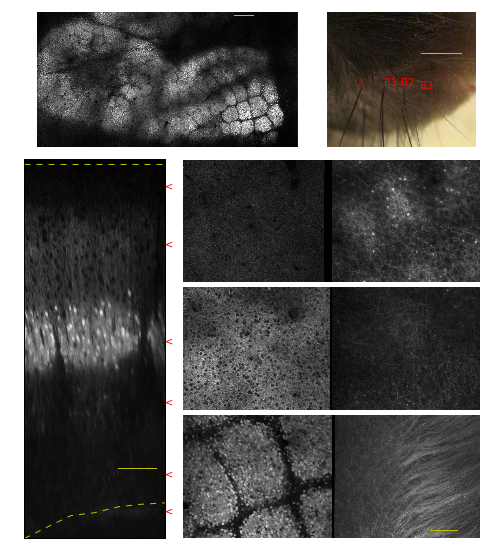

In [58]:
fig = plt.figure(figsize=(6.85, 8.5))
gs1 = gridspec.GridSpec(1, 3, left=0.05, right=1, bottom=0.68, wspace=0, hspace=0)
ax_l4_large = fig.add_subplot(gs1[0, :-1])
ax_l4_large.imshow(L4barrels[0, 0, 3, :, :], 'gray')
pixel_size = 2.5007 # in um
bar300um = 300 / pixel_size
ax_l4_large.plot([1200, 1200 + bar300um], [200, 200], color='y')
ax_l4_large.set_xlim((0, L4barrels.shape[4]))
ax_l4_large.set_ylim((1000, 180))
ax_l4_large.set_axis_off()
ax_whisker_pad = fig.add_subplot(gs1[0, -1])
ax_whisker_pad.imshow(whisker_pad)
ax_whisker_pad.text(920, 750, r'$\beta$', color='r')
ax_whisker_pad.text(1120, 750, 'B1', color='r')
ax_whisker_pad.text(1250, 750, 'B2', color='r')
ax_whisker_pad.text(1390, 770, 'B3', color='r')
ax_whisker_pad.plot([1400, 1400 + 2/scale_factor], [500, 500], color='y')
ax_whisker_pad.set_xlim((700, 1800))
ax_whisker_pad.set_ylim(1200, 200)
ax_whisker_pad.set_axis_off()
low_bottom = 0.04
low_top = 0.66
ax_side_view = fig.add_axes([0.07, low_bottom, 0.3, low_top - low_bottom], )
ax_side_view.imshow(c2_stack[:, 700, :], 'gray')
ax_side_view.set_xlim((500, 1100))
ax_side_view.set_ylim((1800, 180))
ax_side_view.axhline(200, color='y', linestyle='--')
ax_side_view.plot([500, 600, 700, 800, 900, 1000, 1100], [1800, 1750, 1702, 1690, 1665, 1654, 1648], color='y', linestyle='--')
ax_side_view.set_xticks([])
ax_side_view.yaxis.tick_right()
ax_side_view.yaxis.set_tick_params(direction='in', pad=0)
depths = [296, 545, 960, 1219, 1527, 1685]
ax_side_view.set_yticks(depths)
ax_side_view.set_yticklabels(['<' for i in range(len(depths))], color='r')
pixel_size_bottom = 0.6251697
ax_side_view.plot([900, 900 + 100 / pixel_size_bottom], [1500, 1500], color='y')
gs2 = gridspec.GridSpec(3, 2, bottom=low_bottom, top=low_top, left=0.4, right=1, hspace=0.03, wspace=0.01)
for i, depth in enumerate([296, 545, 960, 1219, 1527, 1685]):
    ax = fig.add_subplot(gs2[i%3, i >2])
    ax.imshow(rotate(c2_stack[depth], 26)[680:1430, 600:1500], 'gray')
    ax.set_axis_off()
ax.autoscale(False)
ax.plot([600, 600 + 100 / pixel_size_bottom], [700, 700], color='y');

##### Mouse TK580

In [ ]:
L4barrel = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK580/Anatomy/tile_z_267-517.lsm')
td_2p_image = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK580/Anatomy/stack_tdtom.lsm')
whiskpad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK580/Anatomy/whisker_pad/MC120054.JPG")
plt.figure()
plt.imshow(whiskpad)
plt.title('whisker pad')
plt.text(800, 590, r'$\beta$', color='r')
plt.text(920, 570, 'B1', color='r')
plt.text(1040, 600, 'B2', color='r')
plt.text(1160, 605, 'B3', color='r')
plt.figure()
plt.imshow(L4barrel[0, 0, 2])

##### Mouse TK581

In [ ]:
whiskpad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK581/Anatomy/whisker_pad/MC120058.JPG")
plt.figure()
plt.imshow(whiskpad)
plt.title('whisker pad')
plt.text(550, 800, r'$\beta$', color='r')
plt.text(670, 725, 'B1', color='r')
plt.text(780, 725, 'B2', color='r')
plt.text(930, 720, 'B3', color='r')
plt.text(1050, 720, 'B4', color='r')

##### Mouse TK601

###### figure

In [ ]:
L4barrels = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK601/Anatomy/tile525.ome.tif') # converted from a czi file.
whisker_pad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK601/Anatomy/whisker_pad/MC120062.JPG")
c2_stack = tifffile.imread("C:/Users/kiritani/Documents/data/cells/Tk601/Anatomy/stack0-1276p91.ome.tif")

KeyboardInterrupt: 

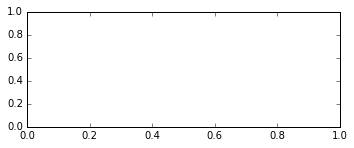

In [60]:
fig = plt.figure(figsize=(6.85, 8))
gs1 = gridspec.GridSpec(1, 3, left=0.05, right=1, bottom=0.7, wspace=0, hspace=0)
ax_l4_large = fig.add_subplot(gs1[0, :-1])
ax_l4_large.imshow(rotate(L4barrels, 135), 'gray')
ax_l4_large.set_ylim((4000, 1200))
ax_l4_large.set_xlim((100, 4300))
ax_l4_large.set_axis_off()
ax_whisker_pad = fig.add_subplot(gs1[0, -1])
ax_whisker_pad.imshow(whisker_pad)
ax_whisker_pad.text(530, 790, r'$\beta$', color='r')
ax_whisker_pad.text(650, 780, 'B1', color='r')
ax_whisker_pad.text(800, 750, 'B2', color='r')
ax_whisker_pad.text(950, 800, 'B3', color='r')
ax_whisker_pad.set_xlim((200, 1400))
ax_whisker_pad.set_ylim(top=200)
ax_whisker_pad.set_axis_off()
low_bottom = 0.04
low_top = 0.66
ax_side_view = fig.add_axes([0.07, low_bottom, 0.3, low_top - low_bottom], )
ax_side_view.imshow(c2_stack[:, 700, :], 'gray', aspect=3.3252872/0.2932506)
ax_side_view.set_ylim((385, 0))
ax_side_view.yaxis.tick_right()
ax_side_view.yaxis.set_tick_params(direction='in', pad=0)
depths = [29, 84, 163, 232, 264, 287,]
ax_side_view.set_yticks(depths)
ax_side_view.set_yticklabels(['<' for i in range(len(depths))], color='r')
ax_side_view.set_xticks([])
vmaxs = []
vmins = []
gs2 = gridspec.GridSpec(3, 2, top=low_top, bottom=low_bottom, left=0.4, right=1, hspace=0.03, wspace=0.01)
for i, depth in enumerate(depths):
    ax = fig.add_subplot(gs2[i%3, i >2])
    vmin = np.percentile(c2_stack[depth], 1)
    vmax = np.percentile(c2_stack[depth], 99)
    ax.imshow(c2_stack[depth,], 'gray', vmin=vmin, vmax=vmax)
    #ax.set_xlim((200, 1500))
    ax.set_axis_off()

##### Mouse TK610

#### PV

##### Mouse TK577

###### figure

In [ ]:
L4barrels = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK577/Anatomy/stack_z_tdtom_400-610.lsm')
whisker_pad = mpimg.imread('C:/Users/kiritani/Documents/data/cells/TK577/Anatomy/whisker_pad/MC120056.JPG')
c2_stack = tifffile.imread("C:/Users/kiritani/Documents/data/cells/Tk577/Anatomy/normalized_rotated_stack_tdtom.tif")

In [ ]:
root = ET.fromstring(bioformats.get_omexml_metadata(path="C:/Users/kiritani/Documents/data/cells/TK577/Anatomy/stack_tdtom_586p92-730p22.lsm"))
nsmap = {'n': 'http://www.openmicroscopy.org/Schemas/OME/2015-01'}
pixels = root.find('n:Image', namespaces=nsmap).find('n:Pixels', namespaces=nsmap)
pixelsize = dict(x=pixels.get('PhysicalSizeX'), y=pixels.get('PhysicalSizeY'), z=pixels.get('PhysicalSizeZ'))

The following imagej macro was used to normalize the light intensity of each slice.

open("C:\\\Users\\\kiritani\\\Documents\\\data\\\cells\\\TK577\\\Anatomy\\\stack_tdtom.ome.tif");<br />
for(i=1;i<nSlices + 1;i++){<br />
	setSlice(i);<br />
    resetMinAndMax();<br />
    run("Enhance Contrast", "saturated=0.35");<br />
    getMinAndMax(min, max);<br />
    factor = 255/(max - min);<br />
    run("Subtract...", "value=" + d2s(min, 2) + " slice");<br />
    run("Multiply...", "value=" + d2s(factor, 4) + " slice");<br />
}<br />
run("Bio-Formats Exporter", "save=C:\\\Users\\\kiritani\\\Documents\\\data\\\cells\\\TK577\\\Anatomy\\\normalized_stack_tdtom.ome.tif export compression=Uncompressed");

In [ ]:
fig = plt.figure(figsize=(6.85, 10))
gs1 = gridspec.GridSpec(1, 3, left=0.05, right=1, bottom=0.7, wspace=0, hspace=0)
ax_l4_large = fig.add_subplot(gs1[0, :-1])
ax_l4_large.imshow(L4barrels[0, 0, 1, :, :], 'gray', vmin=0, vmax=57)
ax_l4_large.set_ylim((2000, 1000))
ax_whisker_pad = fig.add_subplot(gs1[0, -1])
ax_whisker_pad.imshow(whisker_pad)
ax_whisker_pad.text(640, 700, r'$\alpha$', color='r')
ax_whisker_pad.text(650, 800, r'$\beta$', color='r')
ax_whisker_pad.text(750, 730, 'B1', color='r')
ax_whisker_pad.text(880, 690, 'B2', color='r')
ax_whisker_pad.text(960, 660, 'B3', color='r')
ax_whisker_pad.text(1080, 620, 'B4', color='r')
ax_whisker_pad.set_xlim((500, 1500))
ax_whisker_pad.set_ylim(top=200)
ax_whisker_pad.set_axis_off()
ax_side_view = fig.add_axes([0.07, 0, 0.3, 0.6], )
ax_side_view.imshow(c2_stack[:, :, 700], 'gray',)
ax_side_view.set_xlim((500, 1100))
ax_side_view.yaxis.tick_right()
ax_side_view.yaxis.set_tick_params(direction='in', pad=0)
depths = [373, 704, 1005, 1260, 1464, 1755]
pia = 250
ax_side_view.set_yticks(depths)
ax_side_view.set_yticklabels(['<' for i in range(len(depths))], color='r')
ax_side_view.axhline(pia, color='r')
##ax_side_view.yaxis.t = 0
gs2 = gridspec.GridSpec(3, 2, top=0.65, left=0.4, right=1, hspace=0.03, wspace=0.01)
for i, depth in enumerate(depths):
    ax = fig.add_subplot(gs2[i%3, i >2])
    ax.imshow(rotate(c2_stack[depth], 45)[700:1500, 800:1500], 'gray')
    ax.set_axis_off()

##### Mouse TK578

###### figure

In [ ]:
L4barrels = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK578/Anatomy/tile_z_tdtom404-584.lsm')
whisker_pad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK578/Anatomy/whisker_pad/MC120053.JPG")
c2_stack = tifffile.imread("C:/Users/kiritani/Documents/data/cells/Tk578/Anatomy/rotated_stack_tdtom.ome.tif")

The following imagej macro was used to rotate the original confocal image and save the data in .ome.tif.

selectWindow("stack0-584um.lsm");<br />
selectWindow("stack586p92-878p92.lsm");<br />
selectWindow("stack878p92-1022um.lsm");<br />
selectWindow("stack1024p92-1168um.lsm");<br />
selectWindow("stack1170p92-1243p92um.lsm");<br />
run("Concatenate...", "  title=[Concatenated Stacks] image1=stack0-584um.lsm image2=stack586p92-878p92.lsm image3=stack878p92-1022um.lsm image4=stack1024p92-1168um.lsm image5=stack1170p92-1243p92um.lsm image6=[-- None --]");<br />
run("Rotate... ", "angle=17 grid=1 interpolation=Bilinear enlarge stack");<br />
run("Reslice [/]...", "output=0.6251697 start=Left");<br />
run("Rotate... ", "angle=-9 grid=1 interpolation=Bilinear enlarge stack");<br />
run("Reslice [/]...", "output=0.6251697 start=Top");<br />
run("Bio-Formats Exporter", "save=C:\\Users\\kiritani\\Documents\\data\\cells\\TK578\\Anatomy\\rotated_stack_tdtom.ome.tif<br />
export compression=Uncompressed");

In [ ]:
fig, gs1, ax_l4_large, ax_whisker_pad, ax_side_view, gs2 = prepare_fig()

ax_l4_large.imshow(L4barrels[0, 0, 1, :, :], 'gray', vmin=0, vmax=37)
ax_l4_large.set_ylim((2000, 1000))
ax_whisker_pad.imshow(whisker_pad)
ax_whisker_pad.text(640, 700, r'$\alpha$', color='r')
ax_whisker_pad.text(650, 800, r'$\beta$', color='r')
ax_whisker_pad.text(750, 730, 'B1', color='r')
ax_whisker_pad.text(880, 690, 'B2', color='r')
ax_whisker_pad.text(960, 660, 'B3', color='r')
ax_whisker_pad.text(1080, 620, 'B4', color='r')
ax_whisker_pad.set_xlim((500, 1500))
ax_whisker_pad.set_ylim(top=250)
ax_side_view.imshow(c2_stack[170:, 600, :], 'gray', vmin=0, vmax=60)
ax_side_view.set_xlim((500, 1100))
ax_side_view.yaxis.set_tick_params(direction='in', pad=0)
depths = [333, 643, 1146, 1287, 1415, 2044]
vmins = [0, 0, 0, 0, 0, 0]
vmaxes = [25, 30, 30, 30, 30, 30]
ax_side_view.set_yticks(depths)
ax_side_view.set_yticklabels(['<' for i in range(len(depths))], color='r')
for i, depth in enumerate(depths):
    ax = fig.add_subplot(gs2[i%3, i >2])
    ax.imshow(rotate(c2_stack[depth], -17)[300:1300, 450:1400], 'gray', vmin=vmins[i], vmax=vmaxes[i])
    ax.set_axis_off()

##### Mouse TK579

###### figure

In [ ]:
L4barrels = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK579/Anatomy/tile_z_439-559.lsm')
whisker_pad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK579/Anatomy/whisker_pad/MC120057.JPG")
c2_stack = tifffile.imread("C:/Users/kiritani/Documents/data/cells/Tk579/Anatomy/stack_tdtom.lsm")

root = ET.fromstring(bioformats.get_omexml_metadata(path='C:/Users/kiritani/Documents/data/cells/TK579/Anatomy/stack_tdtom.lsm'))
nsmap = {'n': 'http://www.openmicroscopy.org/Schemas/OME/2015-01'}
voxel = root.find('n:Image', namespaces=nsmap).find('n:Pixels', namespaces=nsmap)
voxel_size = dict(x=float(voxel.get('PhysicalSizeX')), y=float(voxel.get('PhysicalSizeY')), z=float(voxel.get('PhysicalSizeZ')))

In [ ]:
fig, gs1, ax_l4_large, ax_whisker_pad, ax_side_view, gs2 = prepare_fig()

ax_l4_large.imshow(np.rot90(L4barrels[0, 0, 1, :, :], 3), 'gray', vmin=0, vmax=26)
ax_l4_large.set_xlim((1500, 3300))
ax_l4_large.set_ylim((1000, 200))
ax_l4_large.set_axis_off()
ax_whisker_pad.imshow(whisker_pad)
ax_whisker_pad.text(640, 670, r'$\alpha$', color='r')
ax_whisker_pad.text(650, 800, r'$\beta$', color='r')
ax_whisker_pad.text(750, 700, 'B1', color='r')
ax_whisker_pad.text(880, 650, 'B2', color='r')
ax_whisker_pad.text(960, 590, 'B3', color='r')
ax_whisker_pad.text(1040, 550, 'B4', color='r')
ax_whisker_pad.set_xlim((500, 1150))
ax_whisker_pad.set_ylim((900, 400))
ax_whisker_pad.set_axis_off()
ax_side_view.imshow(c2_stack[0,0,:, 600, :], 'gray', vmin=0, vmax=30)
ax_side_view.set_aspect(voxel_size['z'] / voxel_size['x'])
ax_side_view.set_xlim(left=400)
ax_side_view.yaxis.set_tick_params(direction='in', pad=0)
depths = [36, 110, 179, 215, 237, 323]
vmins = [0, 0, 0, 0, 0, 0]
vmaxes = [25, 30, 30, 30, 30, 30]
ax_side_view.set_yticks(depths)
ax_side_view.set_yticklabels(['<' for i in range(len(depths))], color='r')
for i, depth in enumerate(depths):
    ax = fig.add_subplot(gs2[i%3, i >2])
    ax.imshow(c2_stack[0, 0, depth, :, :], 'gray', vmin=vmins[i], vmax=vmaxes[i])
    ax.set_axis_off()

#### Sst

##### Mouse TK553

In [ ]:
L4barrel = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK0553/Anatomy/tile456um_from_surface.lsm');
td_2p_image = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK0553/Anatomy/stack_tdtomato_980nm_001.tif');
tdtom = td_2p_image[::2]
dapi_2p_image = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK0553/Anatomy/stack_dapi_800nm_001.tif');
L4_tdtom_confo_stack = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK0553/Anatomy/tdtomato_stack_around_c2.lsm');
L4_green_confo_stack = tifffile.imread('C:/Users/kiritani/Documents/data/cells/TK0553/Anatomy/autofluorescence_stack_around_c2.lsm');

In [ ]:
f, axarr = plt.subplots(1, 2)
axarr[0].imshow(L4barrel[0, 0, 0, :, :], 'gray')
axarr[0].set_title('Green fluorescence in L4')
axarr[1].imshow(L4barrel[0, 0, 1, :, :], 'gray', vmax=30)
axarr[1].set_title('tdTomato fluorescence in L4')

#axarr[1, 0].imshow(td_2p_image[572, :, :], 'gray')
#axarr[1, 1].imshow(L4_tdtom_confo_stack[0, 0, 9, :, :], 'gray')

In [ ]:
f, axarr = plt.subplots(5, 2, figsize=(10,20))
axarr[0, 0].imshow(td_2p_image[400, :, :], 'gray', vmax=1000)
axarr[0, 0].set_title('tdtom in L2/3')
axarr[0, 1].imshow(dapi_2p_image[401, :, :], 'gray', vmax=1000)
axarr[0, 1].set_title('dapi in L2/3')

axarr[1, 0].imshow(td_2p_image[600, :, :], 'gray', vmax=1000)
axarr[1, 0].set_title('tdtom in L4')
axarr[1, 1].imshow(dapi_2p_image[601, :, :], 'gray', vmax=1000)
axarr[1, 1].set_title('dapi in L4')

axarr[2, 0].imshow(td_2p_image[800, :, :], 'gray', vmax=1000)
axarr[2, 0].set_title('tdtom in L2/3')
axarr[2, 1].imshow(dapi_2p_image[801, :, :], 'gray', vmax=1000)
axarr[2, 1].set_title('dapi in L2/3')

axarr[4, 1].imshow(dapi_2p_image[0::2,:,400],'gray')
axarr[4, 1].set_aspect(2)

In [ ]:
f, axarr = plt.subplots(3, 2, figsize=(10,20))
L4_tdtom_2p_slice = td_2p_image[582, :, :] 
axarr[0, 0].imshow(L4_tdtom_2p_slice, 'gray', vmax=1000)
axarr[0, 0].set_title('tdtom in L4')

L4_tdtom_confo_slice = L4_tdtom_confo_stack[0, 0, 9, : ,:]
axarr[0, 1].imshow(L4_tdtom_confo_slice, 'gray', vmin=0, vmax=150)

axarr[1, 0].imshow(L4_tdtom_2p_slice, 'gray', vmax=1000)
axarr[1, 0].set_title('tdtom in L4')

L4_tdtom_confo_slice = L4_tdtom_confo_stack[0, 0, 9, : ,:]

transformed = np.zeros((1024, 1024))
h = 950
w = 900
transformed[39:h + 39, 47:w + 47] = rotate(zoom(L4_tdtom_confo_slice, (1.97, 2.03)), 95.8)[100:h + 100, 0:w]
axarr[1, 1].imshow(transformed, 'gray', vmin=0, vmax=150)
axarr[2, 1].imshow(transformed, 'gray', vmin=0, vmax=150)
super_imposed = np.dstack((L4_tdtom_2p_slice, transformed, np.zeros((1024, 1024))))
super_imposed[:, :, 0] = super_imposed[:, :, 0] / 1000
super_imposed[:, :, 1] = super_imposed[:, :, 1] / 100
axarr[2, 0].imshow(super_imposed,)

In [ ]:
with open("C:/Users/kiritani/Documents/data/cells/TK0553/Anatomy/septum.roi", "rb") as f:
    septum_roi = ijroi.read_roi(f)
    
with open("C:/Users/kiritani/Documents/data/cells/TK0553/Anatomy/barrel.roi", "rb") as f:
    barrel_roi = ijroi.read_roi(f)

In [ ]:
f, axarr = plt.subplots(3, 2, figsize=(10,20))
#L4_tdtom_2p_slice = td_2p_image[576, :, :] 
#axarr[0, 0].imshow(L4_tdtom_2p_slice, 'gray', vmax=1000)
#axarr[0, 0].set_title('tdtom in L4')


L4_green_confo_slice = L4_green_confo_stack[0, 0, 20, : ,:]
transformed_green = np.zeros((1024, 1024))
transformed_green[39:h + 39, 47:w + 47] = rotate(zoom(L4_green_confo_slice, (1.97, 2.03)), 95.9)[100:h + 100, 0:w]
axarr[0, 0].imshow(transformed_green, 'gray', )
axarr[0, 1].imshow(transformed_green, 'gray', )
import scipy.misc
scipy.misc.imsave('outfile.jpg', transformed_green)
from matplotlib.patches import Polygon
barrel = Polygon(barrel_roi[:, ::-1], alpha=0.3)
axarr[0, 1].add_patch(barrel)

septum = Polygon(septum_roi[:, ::-1], alpha=0.3)

axarr[0, 1].add_patch(septum);

##### Mouse TK594

###### figure

In [ ]:
path = 'C:/Users/kiritani/Documents/data/cells/TK594/Anatomy/tile500um_green.czi'
root = ET.fromstring(bioformats.get_omexml_metadata(path=path))
nsmap = {'n': 'http://www.openmicroscopy.org/Schemas/OME/2015-01'}
pixel = root.find('n:Image', namespaces=nsmap).find('n:Pixels', namespaces=nsmap)
pixel_size = dict(x=float(pixel.get('PhysicalSizeX')), y=float(pixel.get('PhysicalSizeY')), )
L4barrels = bioformats.load_image(path, z=0, c=0, rescale=False)

In [ ]:
whisker_pad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK594/Anatomy/whisker_pad/MC120061.JPG")

In [ ]:
fig, gs1, ax_l4_large, ax_whisker_pad, ax_side_view, gs2 = prepare_fig()

ax_l4_large.imshow(rotate(L4barrels, -40), 'gray', vmin=30, vmax=135)
ax_l4_large.set_ylim((2150, 1500))
ax_l4_large.set_xlim((850, 2250))
ax_whisker_pad = fig.add_subplot(gs1[0, -1])
ax_whisker_pad.imshow(whisker_pad)

ax_whisker_pad.text(650, 570, r'$\alpha$', color='red')
ax_whisker_pad.text(550, 650, r'$\beta$', color='red')
ax_whisker_pad.text(700, 650, 'B1', color='red')
ax_whisker_pad.text(800, 650, 'B2', color='red')
ax_whisker_pad.text(910, 650, 'B3', color='red')
ax_whisker_pad.text(970, 650, 'B4', color='red')
ax_whisker_pad.set_xlim((500, 1050))
ax_whisker_pad.set_ylim((900, 400))
#ax_whisker_pad.text(640, 700, r'$\alpha$', color='r')
#ax_whisker_pad.text(650, 800, r'$\beta$', color='r')
#ax_whisker_pad.text(750, 730, 'B1', color='r')
#ax_whisker_pad.text(880, 690, 'B2', color='r')
#ax_whisker_pad.text(960, 660, 'B3', color='r')
#ax_whisker_pad.text(1080, 620, 'B4', color='r')
#ax_whisker_pad.set_xlim((500, 1500))
#ax_whisker_pad.set_ylim(top=200)
#ax_whisker_pad.set_axis_off()
#ax_side_view = fig.add_axes([0.07, 0, 0.3, 0.6], )
ax_side_view.imshow(c2_stack_raw[:, :, 700], 'gray', aspect=voxel_size['z'] / voxel_size['x'], vmin=0, vmax=150)
#ax_side_view.set_xlim((500, 1100))
ax_side_view.yaxis.tick_right()
ax_side_view.yaxis.set_tick_params(direction='in', pad=0)
depths = [21, 91, 163, 200, 277, 338]
#pia = 250
ax_side_view.set_yticks(depths)
ax_side_view.set_yticklabels(['<' for i in range(len(depths))], color='r')
#ax_side_view.axhline(pia, color='r')

for i, depth in enumerate(depths):
    ax = fig.add_subplot(gs2[i%3, i >2])
    ax.imshow(c2_stack_raw[depth], 'gray')
    ax.set_axis_off()

In [ ]:
whiskpad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK594/Anatomy/whisker_pad/MC120061.JPG")
plt.figure()
plt.imshow(whiskpad)
plt.title('whisker pad')
plt.text(650, 570, r'$\alpha$', color='red')
plt.text(550, 650, r'$\beta$', color='red')
plt.text(700, 650, 'B1', color='red')
plt.text(800, 650, 'B2', color='red')
plt.text(910, 650, 'B3', color='red')
plt.text(970, 650, 'B4', color='red')
plt.xlim((400, 1100))
plt.ylim((1000, 200))

##### Mouse TK595

###### figure

In [ ]:
L4barrels, pixel_size = load_bioformats_img('C:/Users/kiritani/Documents/data/cells/TK594/Anatomy/tile500um_green.czi', z=0, c=0)

In [ ]:
whisker_pad = mpimg.imread("C:/Users/kiritani/Documents/data/cells/TK594/Anatomy/whisker_pad/MC120061.JPG")

In [ ]:
fig, gs1, ax_l4_large, ax_whisker_pad, ax_side_view, gs2 = prepare_fig()

ax_l4_large.imshow(rotate(L4barrels, -40), 'gray', vmin=30, vmax=135)
ax_l4_large.set_ylim((2150, 1500))
ax_l4_large.set_xlim((850, 2250))
ax_l4_large.set_axis_off()
ax_whisker_pad = fig.add_subplot(gs1[0, -1])
ax_whisker_pad.imshow(whisker_pad)
ax_whisker_pad.text(650, 570, r'$\alpha$', color='red')
ax_whisker_pad.text(550, 650, r'$\beta$', color='red')
ax_whisker_pad.text(700, 650, 'B1', color='red')
ax_whisker_pad.text(800, 650, 'B2', color='red')
ax_whisker_pad.text(910, 650, 'B3', color='red')
ax_whisker_pad.text(970, 650, 'B4', color='red')
ax_whisker_pad.set_xlim((500, 1050))
ax_whisker_pad.set_ylim((900, 400))
ax_whisker_pad.set_axis_off()

ax_side_view.imshow(c2_stack_raw[:, :, 700], 'gray', aspect=voxel_size['z'] / voxel_size['x'], vmin=0, vmax=50)
#ax_side_view.set_xlim((500, 1100))
ax_side_view.yaxis.tick_right()
ax_side_view.yaxis.set_tick_params(direction='in', pad=0)
depths = [28, 91, 163, 200, 270, 338]
#pia = 250
ax_side_view.set_yticks(depths)
ax_side_view.set_yticklabels(['<' for i in range(len(depths))], color='r')
ax_side_view.set_xticks([])
#ax_side_view.axhline(pia, color='r')

for i, depth in enumerate(depths):
    ax = fig.add_subplot(gs2[i%3, i >2])
    ax.imshow(c2_stack_raw[depth], 'gray', vmin=0, vmax=40)
    ax.set_axis_off()

In [ ]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(c2_stack_raw[163], 'gray', vmin=0, vmax=40)
axes[0].set_axis_off()
axes[0].set_title('tdtom')
axes[1].imshow(c2_stack_raw_green[5], 'gray', vmin=20, vmax=70)
axes[1].set_axis_off()
axes[1].set_title('autofluorescence')

##### Mouse TK596

##### Mouse TK600

###### figure

In [ ]:
img_barrels, pixel_barrels = load_bioformats_img(path='C:/Users/kiritani/Documents/data/cells/TK600/Anatomy/green_tile430-520.czi', c=0, z=2)
img_whiskers, pixel_whiskers = load_bioformats_img(path='C:/Users/kiritani/Documents/data/cells/TK600/Anatomy/whiskers/whiskers_MMStack_Pos0.ome.tif')

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2)
axes[0].imshow(img_barrels[0, 200:1000, 300:1000], 'gray')
axes[0].text(50, 420, 'B1', color='red')
axes[0].text(180, 370, 'B2', color='red')
axes[0].text(320, 320, 'B3', color='red')
axes[0].text(420, 270, 'B4', color='red')
axes[0].set_autoscale_on(False)
axes[0].plot([100, 100 + 200/pixel_barrels['y']], [100, 100], 'yellow')
axes[0].set_axis_off()

axes[1].imshow(img_whiskers[0], 'gray')
axes[1].text(200, 400, r'$\beta$', color='red')
axes[1].text(400, 400, 'B1', color='red')
axes[1].text(600, 430, 'B2', color='red')
axes[1].text(780, 480, 'B3', color='red')
axes[1].text(900, 530, 'B4', color='red')
axes[1].set_autoscale_on(False)
axes[1].plot([100, 100 + 2000/pixel_whiskers['y']], [100, 100], 'yellow')
axes[1].set_axis_off()

In [ ]:
fig = plt.figure(figsize=(8.5, 11), dpi= 160, )
gs = gridspec.GridSpec(4, 3, hspace=0.01, wspace=0, 
#                       width_ratios=[1, 2],
#                       height_ratios=[4, 1]
                       )
ax_side_view = fig.add_subplot(gs[:, 0])
ax_side_view.imshow(c2_stack_raw[:, 700, :], 'gray', aspect=voxel_size['z'] / voxel_size['x'], vmin=0, vmax=50)
#ax_side_view.set_xlim((500, 1100))
ax_side_view.yaxis.tick_right()
ax_side_view.yaxis.set_tick_params(direction='in', pad=0)
ax_side_view.set_xticks([])
depths = [21, 91, 163, 200, 277, 338, 450, 571]
#pia = 250
ax_side_view.set_yticks(depths)
ax_side_view.set_yticklabels(['<' for i in range(len(depths))], color='r')
#ax_side_view.axhline(pia, color='r')

for i, depth in enumerate(depths):
    ax = fig.add_subplot(gs[i%4, (i > 3) + 1])
    ax.imshow(c2_stack_raw[depth], 'gray', vmin = 0, vmax=70)
    ax.set_axis_off()